# sc-RNA Seq Analysis for Microglia's role in Alzhiemer's disease 


**Harshini Raju**

In [41]:
# Convert gene expression data to DataFrame
expr_df = pd.DataFrame(adata.X.toarray() if hasattr(adata.X, "toarray") else adata.X,
                       index=adata.obs_names,
                       columns=adata.var_names)

# Convert cell metadata to DataFrame
cell_metadata_df = adata.obs

# Convert gene metadata to DataFrame
gene_metadata_df = adata.var


## Quality Control (QC)

In [43]:
# Calculate the total counts per cell and the number of genes per cell
adata.obs["total_counts"] = np.sum(adata.X, axis=1)
adata.obs["n_genes_by_counts"] = np.sum(adata.X > 0, axis=1)


In [44]:
# Example thresholds (adjust based on your dataset and goals)
adata = adata[adata.obs["total_counts"] < 5000, :]       # Filter cells with unusually high total counts (if desired)
adata = adata[adata.obs["n_genes_by_counts"] > 200, :]   # Filter cells with very few detected genes


In [45]:
# List all columns in adata.obs to see added QC metrics
print(adata.obs.columns)


Index(['total_counts', 'n_genes_by_counts'], dtype='object')


## Unimodal Analysis

In [46]:
import scanpy as sc

# Normalize total expression to 10,000 counts per cell (standard practice)
sc.pp.normalize_total(adata, target_sum=1e4)

# Log-transform the data for better distribution
sc.pp.log1p(adata)


/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


### HVG

In [47]:
# Identify highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

# Filter the data to keep only highly variable genes
adata = adata[:, adata.var.highly_variable]


In [48]:
# Scale each gene to have a mean of 0 and variance of 1
sc.pp.scale(adata, max_value=10)


/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:318: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


### Dimensionality Reduction

In [49]:
# Run PCA
sc.tl.pca(adata, svd_solver='arpack')


In [50]:
# Compute a neighbor graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

# Run UMAP for visualization
sc.tl.umap(adata)


In [51]:
# Run Louvain clustering
sc.tl.louvain(adata, resolution=0.5)


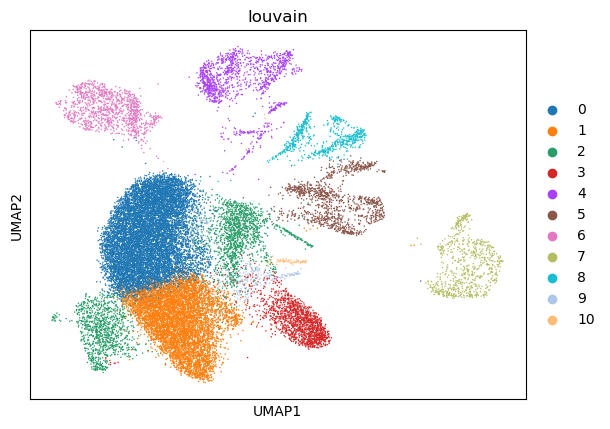

In [23]:
# Plot UMAP with Louvain clusters
sc.pl.umap(adata, color='louvain')


The UMAP plot shows distinct clusters of cells, indicating diverse cell types or states. Clusters' proximity and separation suggest biological relationships or transitions between these cell populations.

In [24]:
adata.var

,highly_variable,means,dispersions,dispersions_norm,mean,std
0610007P08Rik,True,0.113625,2.950187,0.880316,0.026094,0.245988
0610009B22Rik,True,0.228538,2.749725,0.503010,0.057486,0.362644
0610009L18Rik,True,0.034260,2.850483,0.692656,0.007437,0.133197
0610010F05Rik,True,0.090689,2.848614,0.689137,0.021058,0.220546
0610010O12Rik,True,0.013344,3.224421,1.396477,0.002842,0.080867
...,...,...,...,...,...,...
Zxdc,True,0.192911,2.921695,0.826688,0.046247,0.326706
Zzef1,True,0.290865,2.850610,0.692894,0.072271,0.409810
l7Rn6,True,0.202836,2.886920,0.761235,0.047873,0.335098
mmu-mir-689-2,True,0.410526,3.227574,1.798659,0.116547,0.499226


In [25]:
print(adata.shape)  # Check dimensions of adata to ensure it's not empty


(26627, 5737)


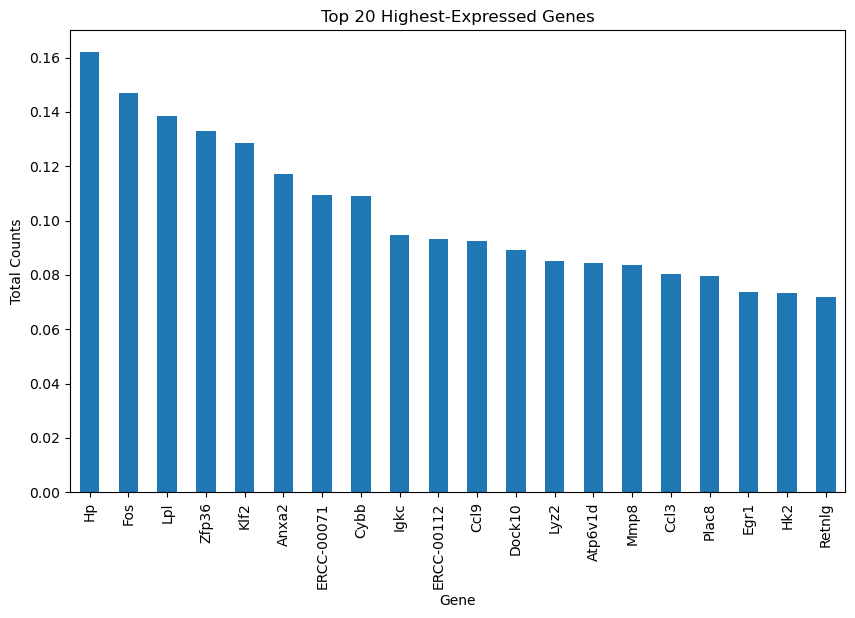

In [26]:
import pandas as pd
import matplotlib.pyplot as plt

# Sum counts across all cells for each gene
gene_sums = pd.DataFrame(adata.X.sum(axis=0).T, index=adata.var_names, columns=['total_counts'])
gene_sums = gene_sums.sort_values(by='total_counts', ascending=False)

# Select top 20 highest-expressed genes
top_genes = gene_sums.head(20)

# Plot
plt.figure(figsize=(10, 6))
top_genes['total_counts'].plot(kind='bar')
plt.title('Top 20 Highest-Expressed Genes')
plt.xlabel('Gene')
plt.ylabel('Total Counts')
plt.show()


### Filtering Cells 

In [27]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [28]:
sc.tl.pca(adata, svd_solver="arpack")

In [29]:
adata.obs

,total_counts,n_genes_by_counts,louvain,n_genes
W660507,3783,893,2,201
W660529,4460,945,2,211
W660596,4215,781,1,200
W660615,4444,1000,2,225
W660787,4500,996,2,215
...,...,...,...,...
W625850,3789,939,1,231
W625882,3096,821,1,227
W625890,3011,787,1,215
W625913,3628,1025,1,274


In [30]:
adata.var['highly_variable']

0610007P08Rik    True
0610009B22Rik    True
0610009L18Rik    True
0610010F05Rik    True
0610010O12Rik    True
                 ... 
Zxdc             True
Zzef1            True
l7Rn6            True
mmu-mir-689-2    True
snoU89           True
Name: highly_variable, Length: 5737, dtype: bool

In [31]:
# Filter adata to only keep highly variable genes (assuming they are already marked in adata.var)
adata_hvg = adata[:, adata.var['highly_variable']]

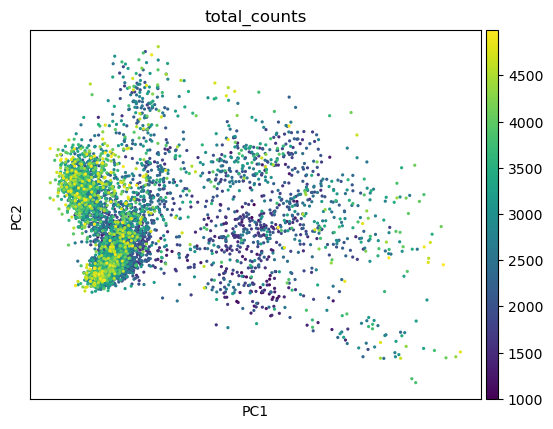

In [32]:
# Plot PCA results
sc.pl.pca(adata_hvg, color='total_counts')  # Color by a column in adata.obs, e.g., total counts per cell

## Multimodal Data Analysis

In [38]:
!pip install -q mudata

In [7]:
import mudata as mu
import numpy as np

### Making a MuData File

In [8]:
adata = sc.read("GSM_preprocessed_with_metadata.h5ad")

In [10]:
# Set the recommended options for future compatibility
# mu.set_options(pull_on_update=False)

# Assuming `combined_data` is the consolidated DataFrame of gene expression.
# adata = mu.AnnData(combined_data.T)  # Transpose to have cells as rows

# Save as a muData object
mdata = mu.MuData({"modality1": adata})
mdata.write("multimodal_data.h5mu")

print("muData object created and saved with updated behavior.")

muData object created and saved with updated behavior.


In [11]:
# Load the saved muData object
loaded_mdata = mu.read("multimodal_data.h5mu")

# Access specific modalities
modality_data = loaded_mdata["modality1"]

# Example analysis: summary statistics
print(modality_data.X.mean(axis=0))


[0.00069802 0.14782002 0.06813789 ... 0.00158398 0.00238939 0.        ]


In [12]:
print(loaded_mdata)
print("Modalities:", loaded_mdata.mod.keys())  # List the available modalities

MuData object with n_obs × n_vars = 37248 × 34016
  1 modality
    modality1:	37248 x 34016
      obs:	'Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample', 'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype', 'DATASTORE provider', 'DATASTORE region', 'Experiment', 'GEO_Accession (exp)', 'Instrument', 'LibraryLayout', 'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism', 'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker', 'source_name', 'SRA Study', 'strain', 'treatment'
Modalities: dict_keys(['modality1'])


In [13]:
print("Shape of data matrix:", modality_data.X.shape)

# Example: Summary statistics
print("Mean expression per gene:", modality_data.X.mean(axis=0)[:5])  # Mean of first 5 genes

Shape of data matrix: (37248, 34016)
Mean expression per gene: [0.00069802 0.14782002 0.06813789 0.01691366 0.02926332]


In [14]:
def simple_pca(mdata):
    from sklearn import decomposition

    x = np.hstack([m.X for m in mdata.mod.values()])

    pca = decomposition.PCA(n_components=2)
    components = pca.fit_transform(x)

    # By default, methods operate in-place and embeddings are stored in the .obsm slot
    mdata.obsm["X_pca"] = components

In [15]:
simple_pca(loaded_mdata)
print(loaded_mdata)

MuData object with n_obs × n_vars = 37248 × 34016
  obsm:	'X_pca'
  1 modality
    modality1:	37248 x 34016
      obs:	'Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample', 'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype', 'DATASTORE provider', 'DATASTORE region', 'Experiment', 'GEO_Accession (exp)', 'Instrument', 'LibraryLayout', 'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism', 'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker', 'source_name', 'SRA Study', 'strain', 'treatment'


In [16]:
from sklearn.cluster import KMeans

# Apply KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=0)
clusters = kmeans.fit_predict(modality_data.X)  # Use modality_data.X directly

# Add cluster labels to the modality's observations
modality_data.obs['cluster'] = clusters

# Inspect the clusters
print(modality_data.obs['cluster'].value_counts())


cluster
1    19501
2    13242
0     4505
Name: count, dtype: int64


In [17]:
!pip install -q muon

### Analysis on MuData

In [1]:
import muon as mu
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import random
import pandas as pd
import anndata as ad

In [74]:
# Load the muData object
mdata = mu.read("multimodal_data.h5mu")

In [75]:
# Select the modality with gene expression data
rna_data = mdata['modality1']

rna_data.X = rna_data.X.astype(float)

#### Data Cleaning 

In [76]:
import numpy as np

# Check for infinities or NaNs in the data
print("Contains NaN values:", np.isnan(rna_data.X).any())
print("Contains infinity values:", np.isinf(rna_data.X).any())


Contains NaN values: False
Contains infinity values: False


In [77]:
# Filter out genes with NaN or infinity
mask = np.isfinite(rna_data.X).all(axis=0)
rna_data = rna_data[:, mask]
print("Data shape after filtering:", rna_data.shape)


Data shape after filtering: (37248, 34016)


In [78]:
# Calculate variance of each gene
gene_variances = rna_data.X.var(axis=0)

# Filter out genes with zero variance
nonzero_variance_mask = gene_variances > 0
rna_data = rna_data[:, nonzero_variance_mask]

print(f"Data shape after filtering zero-variance genes: {rna_data.shape}")

Data shape after filtering zero-variance genes: (37248, 22951)


In [ ]:
# Compute mean expression per gene
gene_means = rna_data.X.mean(axis=0)

# Inspect the range and distribution
print(f"Min mean: {gene_means.min()}, Max mean: {gene_means.max()}")
print("Top 5 highest mean values:", np.sort(gene_means)[-5:])


Min mean: 2.6847079037800687e-05, Max mean: 94.98512671821305
Top 5 highest mean values: [30.8449312715 57.0334246134 60.8759128007 77.3898195876 94.9851267182]


In [ ]:
# Cap mean values at the 99th percentile to limit extreme outliers
capped_means = np.clip(gene_means, None, np.percentile(gene_means, 99))

# Reassign capped means back to the data (to keep original means for later)
rna_data.var['capped_mean'] = capped_means

# Use the capped mean for highly variable gene calculation
sc.pp.highly_variable_genes(rna_data, flavor="cell_ranger", n_top_genes=2000)

/state/partition1/job-54240897/ipykernel_1037861/3970486573.py:5: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  rna_data.var['capped_mean'] = capped_means


In [ ]:
# Subset highly variable genes
rna_data = rna_data[:, rna_data.var['highly_variable']]
print(f"Highly variable genes selected: {rna_data.shape}")


Highly variable genes selected: (37248, 2018)


In [ ]:
# Calculate the total counts per cell and the number of genes per cell
rna_data.obs["total_counts"] = np.sum(rna_data.X, axis=1)
rna_data.obs["n_genes_by_counts"] = np.sum(rna_data.X > 0, axis=1)


/state/partition1/job-54240897/ipykernel_1037861/386299526.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_data.obs["total_counts"] = np.sum(rna_data.X, axis=1)


In [ ]:
rna_data.obs["total_counts"]

W660497     532.0
W660498    1221.0
W660499    1260.0
W660500    1252.0
W660501    1097.0
            ...  
W625932     746.0
W625933    1032.0
W625934     914.0
W625935    1609.0
W625936     921.0
Name: total_counts, Length: 37248, dtype: float64

In [ ]:
rna_data.obs["n_genes_by_counts"]

W660497     47
W660498     76
W660499     82
W660500     69
W660501     72
          ... 
W625932     70
W625933     86
W625934     80
W625935    119
W625936     74
Name: n_genes_by_counts, Length: 37248, dtype: int64

In [ ]:
print(f"Highly variable genes selected: {rna_data.shape}")

Highly variable genes selected: (37248, 2018)


#### Normalizing and scaling data

In [ ]:
# Log-normalize data for each modality
sc.pp.normalize_total(rna_data, target_sum=1e4)
sc.pp.log1p(rna_data)

# Scale the data
sc.pp.scale(rna_data)


/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


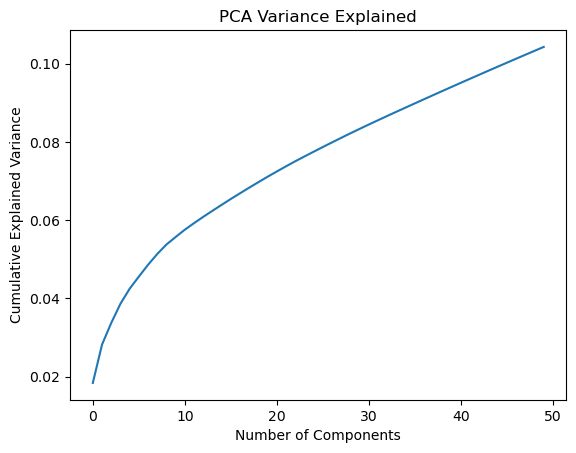

In [ ]:
# Perform PCA
sc.tl.pca(rna_data, n_comps=50)

# Visualize the variance explained by each component
plt.plot(np.cumsum(rna_data.uns['pca']['variance_ratio']))
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("PCA Variance Explained")
plt.show()


In [ ]:
# Compute the neighborhood graph
sc.pp.neighbors(rna_data, n_neighbors=10, n_pcs=50)  # Adjust n_pcs based on prior PCA

#### PCA and UMAP

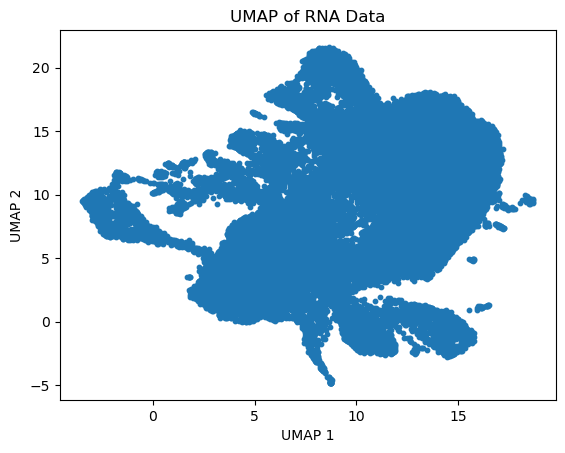

In [ ]:
# Compute UMAP on the PCA-reduced data
sc.tl.umap(rna_data)

# Plot UMAP results
plt.scatter(rna_data.obsm['X_umap'][:, 0], rna_data.obsm['X_umap'][:, 1], s=10)
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("UMAP of RNA Data")
plt.show()


In [ ]:
!pip3 install -q leidenalg

#### Leiden Clustering

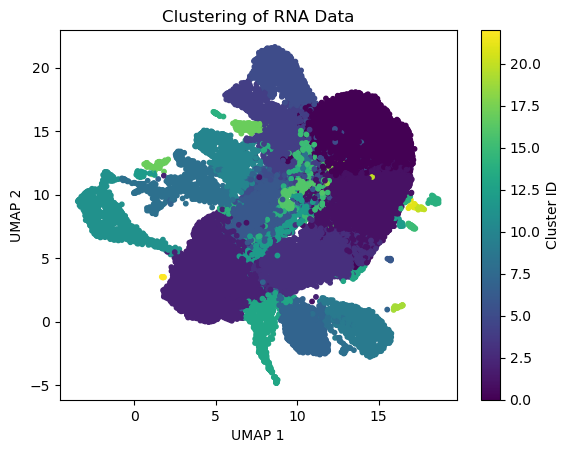

In [ ]:
# Perform clustering
mu.tl.leiden(rna_data, resolution=0.5)

# Convert cluster labels to numeric
cluster_numeric = rna_data.obs['leiden'].astype(int)

# Convert leiden cluster labels to integers
rna_data.obs['leiden_numeric'] = rna_data.obs['leiden'].astype('category').cat.codes

# Plot clusters using the numeric cluster labels
plt.scatter(
    rna_data.obsm['X_umap'][:, 0],
    rna_data.obsm['X_umap'][:, 1],
    c=rna_data.obs['leiden_numeric'],
    s=10,
    cmap='viridis'
)
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.title("Clustering of RNA Data")

plt.colorbar(label="Cluster ID")
plt.show()


The UMAP plot you generated shows the clustering of your RNA data after dimensionality reduction and clustering. Here's what the plot tells us:

**Key Observations:**
1. **Clusters (Colors)**:
   - The plot displays distinct clusters, each represented by a different color.
   - Each color corresponds to a different Leiden cluster ID, as indicated by the color bar.

2. **Separation of Clusters**:
   - Some clusters are well-separated, indicating distinct groups of cells with different gene expression profiles.
   - Overlapping clusters suggest potential biological similarities or gradual transitions between cell states.

3. **Density and Spread**:
   - The density of points within a cluster varies. Dense regions could indicate cell types with a high degree of similarity.
   - More spread-out clusters might represent heterogeneous populations or transitional states.

4. **Cluster Sizes**:
   - Some clusters are larger than others, suggesting that certain cell types or states are more prevalent in your dataset.

**Biological Implications:**
- **Distinct Cell Types or States**:
  - The separation into clusters likely corresponds to different cell types, subtypes, or distinct cellular states.

- **Heterogeneous Populations**:
  - Overlapping clusters or transitional regions may represent cells transitioning from one state to another or mixed populations.

- **Potential Outliers**:
  - Any small, isolated clusters could be rare cell types or potentially outliers depending e with any of these follow-up analyses?

#### Identifying Marker Genes for Each Cluster

Marker genes help determine the biological identity of each cluster by highlighting genes that are highly expressed in a specific cluster compared to others.

Cell-Type Marker Genes:

The figure provides a list of validated marker genes for neurons, astrocytes, and microglia:
Neurons (NeuN+):
Markers: Rbfox3, Grin1, Cx3cl1, Nos1
Astrocytes (GFAP+):
Markers: Gfap, Aldh1l1, Aqp4, Slc1a2
Microglia (CD11b+):
Markers: Itgam (CD11b), Aif1, Cx3cr1, Ptprc (CD45)
These genes can be directly used to annotate clusters in your dataset. For example:
If a cluster shows high expression of Rbfox3 or Grin1, it likely represents neurons.
If a cluster expresses Gfap or Aldh1l1, it may represent astrocytes.
If Itgam or Aif1 is highly expressed, it could correspond to microglia.

/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:434: PerformanceWarning: DataFrame is highly fragmented.  This is 

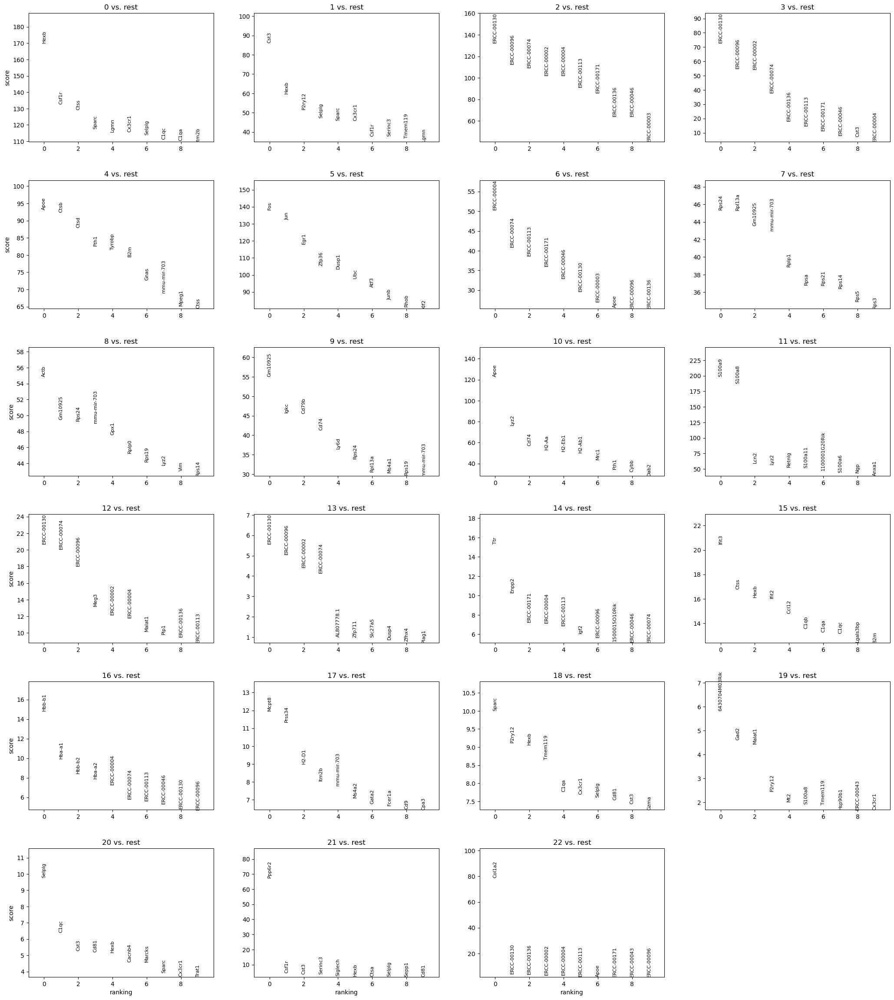

In [130]:
rna_data.X = np.nan_to_num(rna_data.X, nan=0)  # Replace NaNs with 0
rna_data.X = np.clip(rna_data.X, a_min=0, a_max=None)  # Set all negative values to 0

# Apply log1p transformation to stabilize variance
sc.pp.log1p(rna_data)

# Run differential expression
sc.tl.rank_genes_groups(rna_data, 'leiden', method='t-test')

# Plot top marker genes
sc.pl.rank_genes_groups(rna_data, n_genes=10, sharey=False)


In [131]:
# Select a random cell from cluster '0' as the root
root_cluster = '0'  # Change this based on your biological knowledge
root_cell_index = rna_data.obs[rna_data.obs['leiden'] == root_cluster].index[0]

# Set the root cell
rna_data.uns['iroot'] = rna_data.obs.index.get_loc(root_cell_index)


In [132]:
# Compute the neighborhood graph if not already done
sc.pp.neighbors(rna_data, n_neighbors=10, use_rep='X_pca')  # Ensure PCA was run

# Compute diffusion map (required for pseudotime)
sc.tl.diffmap(rna_data)

# Set the root cell for pseudotime (usually the cluster with most naive or progenitor cells)
rna_data.obs['root_cell'] = (rna_data.obs['leiden'] == '0')  # Adjust based on known biology

# Calculate pseudotime
sc.tl.dpt(rna_data, n_dcs=10)


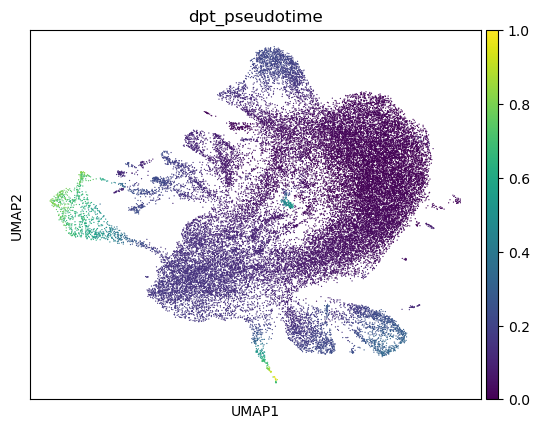

In [133]:
# Visualize UMAP with pseudotime

sc.pl.umap(rna_data, color='dpt_pseudotime', color_map='viridis')


**Plot 2: Pseudotime Projection on UMAP**

- **Color Gradient**: Represents pseudotime, where:
  - Dark purple areas indicate earlier pseudotime (starting cells in the trajectory).
  - Yellow/green areas indicate later pseudotime (more differentiated or terminal cells).

**Key Insights**:
1. **Developmental Trajectories**:
   - Cells in the dark purple regions likely represent early progenitors or naive cells.
   - Cells transitioning to yellow/green regions show progression toward differentiated states, such as monocytes or dendritic cells.

2. **Cluster Overlap**:
   - The smooth gradient from one region to another implies continuous cellular transitions between certain cell types.
   - For example, some cells transition from progenitor-like states (low pseudotime) to monocytes or dendritic cells (high pseudotime).

3. **Dynamic Processes**:
   - Pseudotime reveals dynamic biological processes like ie assistance with further analysis or validation steps?

**Biological Implications:**
1. **Immune Cell Development**:
   - Early pseudotime clusters could represent stem or progenitor cells, while later stages show differentiated immune cells such as monocytes or dendritic cells.
   
2. **Cell Fate Decisions**:
   - Pseudotime gradients suggest how cells transition from one type to another, providing insights into developmental pathways or immune responses.

3. **Potential for Rare Cell Types**:
   - Investigating the "NA" cluster and pseudotime extremes could help identify rare or novel cell types.

#### PAGA

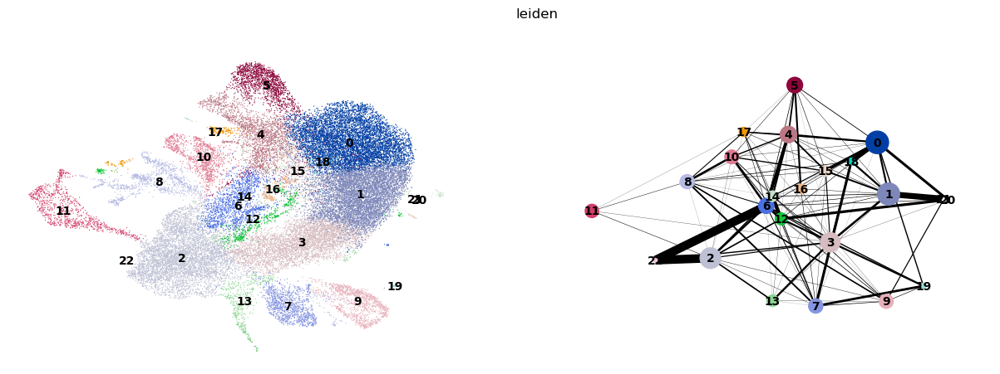

In [89]:
# Run PAGA on the neighborhood graph
sc.tl.paga(rna_data, groups='leiden')

# Visualize PAGA graph over UMAP
sc.pl.paga_compare(rna_data, basis='umap', show=True)


*Interpretation of the PAGA Graph*

The PAGA (Partition-based Graph Abstraction) graph is a powerful tool for visualizing the connectivity and transitions between clusters of cells in your dataset.

**Interpretation:**
1. **Strongly Connected Clusters**:
   - Clusters with thick edges (e.g., between 0, 1, 5, and 6) suggest strong relationships, likely reflecting differentiation pathways or cell-type transitions.
   - For example:
     - Cluster 0 may transition into clusters 1 and 5.
     - Cluster 6 is likely closely related to 0 and 1, possibly representing an intermediate cell state.

2. **Weakly Connected or Isolated Clusters**:
   - Clusters like 8 and 10 show fewer or thinner edges, indicating these are less related to other clusters and may represent more distinct or terminal cell types.

3. **Potential Developmental Trajectories**:
   - The structure of the PAGA graph can be interpreted as a map of possible developmental pathways.
   - Cells may progress from one cluster (e.g., progenitor cells in cluster 0) to more differentiated states in connected clusters.

**** Biological Implications:**
- **Cell Differentiation**:
  - PAGA can help identify differentiation trajectories, such as stem cells (early clusters) transitioning into more mature immune cells (later clusters).
  
- **Transitional States**:
  - Intermediate clusters with strong connections to multiple nodes might represent transitional states, capturing dynamic cellular processes.

- **Potential Rare Cell Types**:
  - Clusters with weak or no connections might be rare cell type

##### Validate PAGA Connectivity

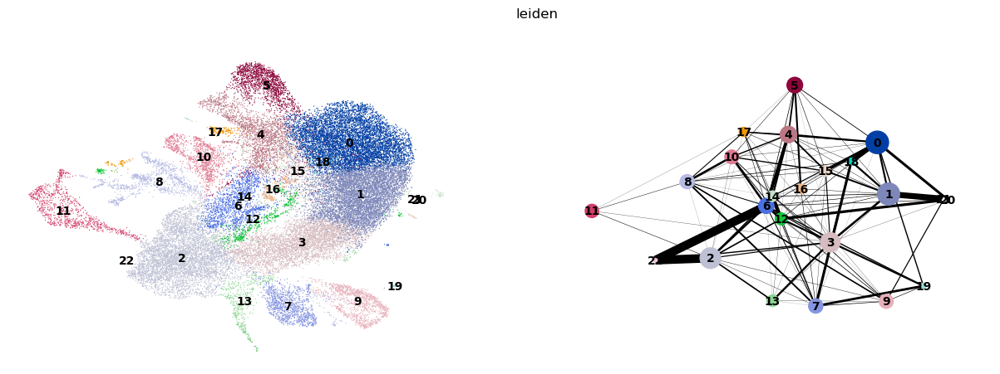

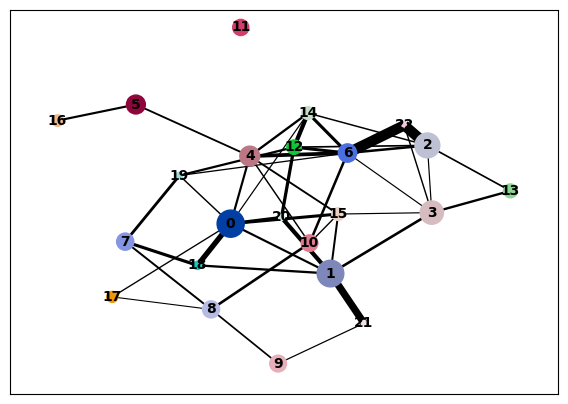

In [91]:
# Recompute PAGA graph to ensure it's updated
sc.tl.paga(rna_data, groups='leiden')

# Visualize the PAGA connectivity on top of UMAP
sc.pl.paga_compare(rna_data, basis='umap', color='leiden', show=True)

# Alternative: Just PAGA graph
sc.pl.paga(rna_data, color='leiden', threshold=0.1, show=True)

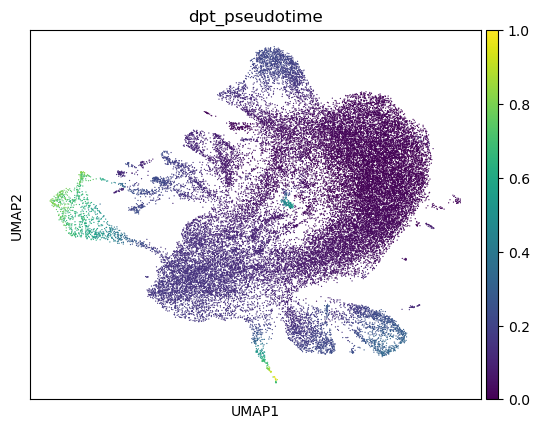

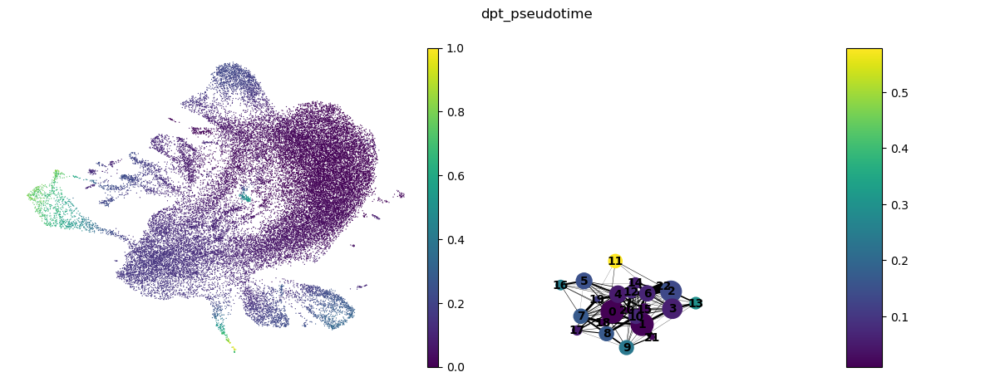

In [93]:
#Pseudotime Analysis along Trajectories

# Recalculate diffusion map and pseudotime
sc.tl.diffmap(rna_data)  # Ensure neighbors were computed beforehand
sc.tl.dpt(rna_data, n_dcs=10)

# Visualize pseudotime on UMAP
sc.pl.umap(rna_data, color='dpt_pseudotime', color_map='viridis')

# Combine with PAGA visualization
sc.pl.paga_compare(rna_data, basis='umap', color='dpt_pseudotime', show=True)


#### Top Marker Genes

In [179]:
rna_data

AnnData object with n_obs × n_vars = 37248 × 2018
    obs: 'Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample', 'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype', 'DATASTORE provider', 'DATASTORE region', 'Experiment', 'GEO_Accession (exp)', 'Instrument', 'LibraryLayout', 'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism', 'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker', 'source_name', 'SRA Study', 'strain', 'treatment', 'total_counts', 'n_genes_by_counts', 'leiden', 'leiden_numeric'
    var: 'capped_mean', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scan

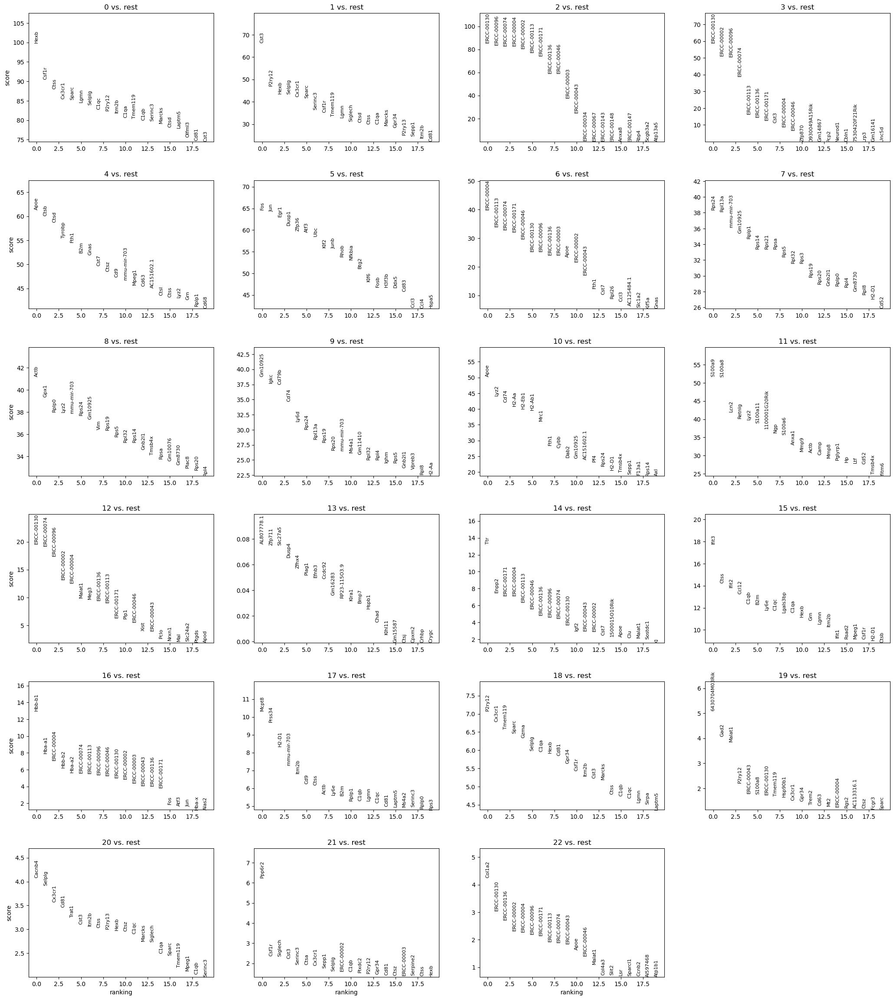

In [180]:
# Rank marker genes for each cluster
sc.tl.rank_genes_groups(rna_data, groupby='leiden', method='wilcoxon')

# Visualize the top marker genes for each cluster
sc.pl.rank_genes_groups(rna_data, n_genes=20, sharey=False)

In [181]:
rna_data.uns['rank_genes_groups']['names']

rec.array([('Hexb', 'Cst3', 'ERCC-00130', 'ERCC-00130', 'Apoe', 'Fos', 'ERCC-00004', 'Rps24', 'Actb', 'Gm10925', 'Apoe', 'S100a9', 'ERCC-00130', 'AL807778.1', 'Ttr', 'Ifit3', 'Hbb-b1', 'Mcpt8', 'P2ry12', '6430704M03Rik', 'Cacnb4', 'Ppp6r2', 'Col1a2'),
           ('Csf1r', 'P2ry12', 'ERCC-00096', 'ERCC-00002', 'Ctsb', 'Jun', 'ERCC-00113', 'Rpl13a', 'Gpx1', 'Igkc', 'Lyz2', 'S100a8', 'ERCC-00074', 'Zfp711', 'Enpp2', 'Ctss', 'Hba-a1', 'Prss34', 'Cx3cr1', 'Gad2', 'Selplg', 'Csf1r', 'ERCC-00130'),
           ('Ctss', 'Hexb', 'ERCC-00074', 'ERCC-00096', 'Ctsd', 'Egr1', 'ERCC-00074', 'mmu-mir-703', 'Rplp0', 'Cd79b', 'Cd74', 'Lcn2', 'ERCC-00096', 'Slc27a5', 'ERCC-00171', 'Ifit2', 'ERCC-00004', 'H2-D1', 'Tmem119', 'Malat1', 'Cx3cr1', 'Siglech', 'ERCC-00136'),
           ...,
           ('ERCC-00096', 'Lyz2', 'Actb', 'B2m', 'ERCC-00074', 'ERCC-00074', 'Selplg', 'Csf1r', 'Sparc', 'Csf1r', 'Cst3', 'Hexb', 'B2m', 'Tmsb4x', 'C1qb', 'ERCC-00074', 'AC113316.1', 'ERCC-00004', 'ERCC-00074', 'Rplp1', 'ERC

In [182]:
rna_data.obs["leiden"]

W660497     3
W660498     1
W660499     1
W660500     1
W660501     6
           ..
W625932     1
W625933    16
W625934     1
W625935     0
W625936     1
Name: leiden, Length: 37248, dtype: category
Categories (23, object): ['0', '1', '2', '3', ..., '19', '20', '21', '22']

In [183]:
# Get the marker gene names for each cluster
marker_genes = rna_data.uns['rank_genes_groups']['names']


# Get top 10 marker genes for each cluster
top_marker_genes_df = pd.DataFrame(marker_genes)
print(top_marker_genes_df)


               0       1           2            3           4           5  \
0           Hexb    Cst3  ERCC-00130   ERCC-00130        Apoe         Fos   
1          Csf1r  P2ry12  ERCC-00096   ERCC-00002        Ctsb         Jun   
2           Ctss    Hexb  ERCC-00074   ERCC-00096        Ctsd        Egr1   
3         Cx3cr1  Selplg  ERCC-00004   ERCC-00074      Tyrobp       Dusp1   
4          Sparc  Cx3cr1  ERCC-00002   ERCC-00113        Fth1       Zfp36   
...          ...     ...         ...          ...         ...         ...   
2013  ERCC-00004    Cd52  AC113316.1         Fth1  ERCC-00004  ERCC-00113   
2014  ERCC-00002   H2-D1        Hexb         Apoe  ERCC-00002  ERCC-00002   
2015  ERCC-00096    Lyz2        Actb          B2m  ERCC-00074  ERCC-00074   
2016  ERCC-00074   Rpl26        Cst3  mmu-mir-703  ERCC-00096  ERCC-00096   
2017  ERCC-00130    Apoe      Tmsb4x         Actb  ERCC-00130  ERCC-00130   

               6            7            8        9  ...          13  \
0  

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns

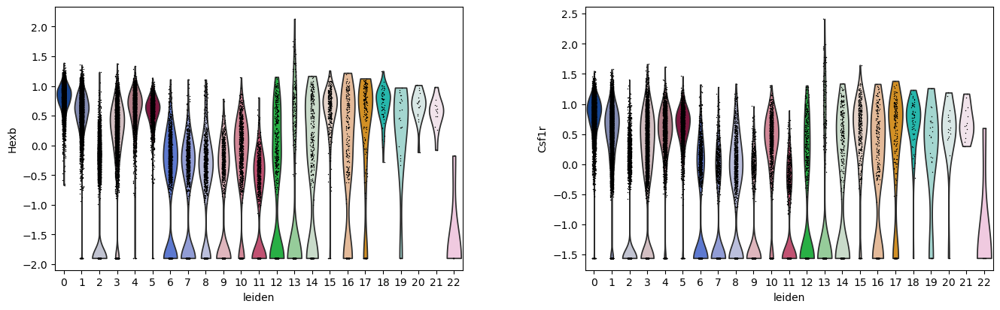

In [185]:
# Plot expression of a specific marker gene
sc.pl.violin(rna_data, keys=['Hexb', 'Csf1r'], groupby='leiden')

**Performing Quality Control and Preprocessing on scRNA-seq Data**

In [144]:
# Calculate QC metrics (total counts, number of genes, top gene percentages)
sc.pp.calculate_qc_metrics(
    rna_data, qc_vars=['highly_variable'], inplace=True
)


rna_data

/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_qc.py:432: RuntimeWarning: invalid value encountered in divide
  return values / sums[:, None]


AnnData object with n_obs × n_vars = 37248 × 2018
    obs: 'Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample', 'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype', 'DATASTORE provider', 'DATASTORE region', 'Experiment', 'GEO_Accession (exp)', 'Instrument', 'LibraryLayout', 'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism', 'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker', 'source_name', 'SRA Study', 'strain', 'treatment', 'total_counts', 'n_genes_by_counts', 'leiden', 'leiden_numeric', 'root_cell', 'dpt_pseudotime', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_highly_variable', 'log1p_total_counts_highly_variable', 'pct_counts_highly_variable'
    var: 'capped_mean', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std', 'n_cells_by_counts', 'mean_counts', 'lo

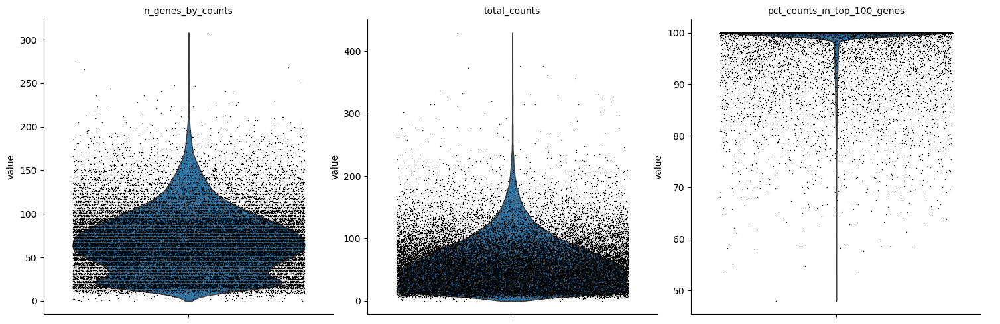

In [145]:
# Visualize the key QC metrics
sc.pl.violin(
    rna_data,
    ['n_genes_by_counts', 'total_counts', 'pct_counts_in_top_100_genes'],
    jitter=0.4,
    multi_panel=True
)


In [146]:
# Filter out cells with too few detected genes or too high total counts
sc.pp.filter_cells(rna_data, min_genes=200)  # Cells with at least 200 genes
sc.pp.filter_cells(rna_data, max_genes=2500)  # Remove cells with too many genes, likely doublets
sc.pp.filter_cells(rna_data, min_counts=500)  # Ensure cells have sufficient total counts


In [147]:
# Normalize counts to the same total for each cell
sc.pp.normalize_total(rna_data, target_sum=1e4)

# Log-transform the normalized data
sc.pp.log1p(rna_data)


## Marker Gene Manual Annotation

In [186]:
print(top_marker_genes_df)

               0       1           2            3           4           5  \
0           Hexb    Cst3  ERCC-00130   ERCC-00130        Apoe         Fos   
1          Csf1r  P2ry12  ERCC-00096   ERCC-00002        Ctsb         Jun   
2           Ctss    Hexb  ERCC-00074   ERCC-00096        Ctsd        Egr1   
3         Cx3cr1  Selplg  ERCC-00004   ERCC-00074      Tyrobp       Dusp1   
4          Sparc  Cx3cr1  ERCC-00002   ERCC-00113        Fth1       Zfp36   
...          ...     ...         ...          ...         ...         ...   
2013  ERCC-00004    Cd52  AC113316.1         Fth1  ERCC-00004  ERCC-00113   
2014  ERCC-00002   H2-D1        Hexb         Apoe  ERCC-00002  ERCC-00002   
2015  ERCC-00096    Lyz2        Actb          B2m  ERCC-00074  ERCC-00074   
2016  ERCC-00074   Rpl26        Cst3  mmu-mir-703  ERCC-00096  ERCC-00096   
2017  ERCC-00130    Apoe      Tmsb4x         Actb  ERCC-00130  ERCC-00130   

               6            7            8        9  ...          13  \
0  

In [187]:
top_marker_genes_df

,0,1,2,3,4,5,6,7,8,9,...,13,14,15,16,17,18,19,20,21,22
0,Hexb,Cst3,ERCC-00130,ERCC-00130,Apoe,Fos,ERCC-00004,Rps24,Actb,Gm10925,...,AL807778.1,Ttr,Ifit3,Hbb-b1,Mcpt8,P2ry12,6430704M03Rik,Cacnb4,Ppp6r2,Col1a2
1,Csf1r,P2ry12,ERCC-00096,ERCC-00002,Ctsb,Jun,ERCC-00113,Rpl13a,Gpx1,Igkc,...,Zfp711,Enpp2,Ctss,Hba-a1,Prss34,Cx3cr1,Gad2,Selplg,Csf1r,ERCC-00130
2,Ctss,Hexb,ERCC-00074,ERCC-00096,Ctsd,Egr1,ERCC-00074,mmu-mir-703,Rplp0,Cd79b,...,Slc27a5,ERCC-00171,Ifit2,ERCC-00004,H2-D1,Tmem119,Malat1,Cx3cr1,Siglech,ERCC-00136
3,Cx3cr1,Selplg,ERCC-00004,ERCC-00074,Tyrobp,Dusp1,ERCC-00171,Gm10925,Lyz2,Cd74,...,Dusp4,ERCC-00004,Ccl12,Hbb-b2,mmu-mir-703,Sparc,P2ry12,Cd81,Cst3,ERCC-00002
4,Sparc,Cx3cr1,ERCC-00002,ERCC-00113,Fth1,Zfp36,ERCC-00046,Rplp1,mmu-mir-703,Ly6d,...,Zfhx4,ERCC-00113,C1qb,Hba-a2,Itm2b,Gzma,ERCC-00043,Trat1,Serinc3,ERCC-00004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013,ERCC-00004,Cd52,AC113316.1,Fth1,ERCC-00004,ERCC-00113,Cx3cr1,Ctss,ERCC-00074,C1qc,...,B2m,Laptm5,ERCC-00171,B2m,ERCC-00002,Fos,Rpl13a,Npm1,Rpl26,B2m
2014,ERCC-00002,H2-D1,Hexb,Apoe,ERCC-00002,ERCC-00002,Csf1r,C1qc,Cst3,Ctsd,...,AC113316.1,Tmsb4x,ERCC-00096,Gm10925,ERCC-00096,Rplp1,Npm1,H3f3b,Rps3,Ctss
2015,ERCC-00096,Lyz2,Actb,B2m,ERCC-00074,ERCC-00074,Selplg,Csf1r,Sparc,Csf1r,...,Tmsb4x,C1qb,ERCC-00074,AC113316.1,ERCC-00004,ERCC-00074,Rplp1,ERCC-00113,Cd52,Serinc3
2016,ERCC-00074,Rpl26,Cst3,mmu-mir-703,ERCC-00096,ERCC-00096,Hexb,Hexb,Hexb,Hexb,...,Actb,AC113316.1,ERCC-00130,Gm11410,ERCC-00130,ERCC-00130,Rps21,ERCC-00004,Rplp0,Hexb


In [188]:
# Assuming your DataFrame is named 'df'
unique_genes = top_marker_genes_df.apply(pd.Series).stack().unique().tolist()

# Print the list of unique gene names
print(unique_genes)


['Hexb', 'Cst3', 'ERCC-00130', 'Apoe', 'Fos', 'ERCC-00004', 'Rps24', 'Actb', 'Gm10925', 'S100a9', 'AL807778.1', 'Ttr', 'Ifit3', 'Hbb-b1', 'Mcpt8', 'P2ry12', '6430704M03Rik', 'Cacnb4', 'Ppp6r2', 'Col1a2', 'Csf1r', 'ERCC-00096', 'ERCC-00002', 'Ctsb', 'Jun', 'ERCC-00113', 'Rpl13a', 'Gpx1', 'Igkc', 'Lyz2', 'S100a8', 'ERCC-00074', 'Zfp711', 'Enpp2', 'Ctss', 'Hba-a1', 'Prss34', 'Cx3cr1', 'Gad2', 'Selplg', 'Ctsd', 'Egr1', 'mmu-mir-703', 'Rplp0', 'Cd79b', 'Cd74', 'Lcn2', 'Slc27a5', 'ERCC-00171', 'Ifit2', 'H2-D1', 'Tmem119', 'Malat1', 'Siglech', 'ERCC-00136', 'Tyrobp', 'Dusp1', 'H2-Aa', 'Retnlg', 'Dusp4', 'Ccl12', 'Hbb-b2', 'Sparc', 'Cd81', 'Fth1', 'Zfp36', 'ERCC-00046', 'Rplp1', 'Ly6d', 'H2-Eb1', 'Zfhx4', 'C1qb', 'Hba-a2', 'Itm2b', 'Gzma', 'ERCC-00043', 'Trat1', 'Serinc3', 'Lgmn', 'B2m', 'Atf3', 'Rps14', 'H2-Ab1', 'S100a11', 'Plag1', 'Cd9', 'Ctsa', 'Gnas', 'Ubc', 'Rps21', 'Mrc1', '1100001G20Rik', 'Meg3', 'Efnb3', 'Ly6e', 'C1qa', 'C1qc', 'Cst7', 'Klf2', 'Rpsa', 'Vim', 'Rps19', 'Ngp', 'Ccdc92', 

Cluster 2 - microglia
cluster 1 - Neurons
P2RY12 - microglia, Serinc3 - mciroglia, 
Cx3cr1 - monocyte
lgmn - macrophage, microglial
Tmem119 - microglia
Serinc3 - microglia
Selplg - microglia
Ctss - microglia
Sparc - Endothelial
C1qc - microglia
cst3 - astrocyte
apoe - astrocyte
cstb - microlgial
Tyrobp - microglia
Fth1 - microglia
B2m - Long-projecting GABAergic cell	; microglia 
Cst7 - Disease-associated microglial cell
ctsz - microglia
CD9 - Disease-associated microglial cell	;Monocyte-derived tumor-associated macrophage(Mo-TAM)	
Actb - Endothelial cell
S100a9 - Monocyte
Ttr - Ependymal cell	
Ifit3 - Microglial cell
Cacnb4 - Neuron
Col1a2 - Vascular cell
Csf1r - Monocyte 
Gpx1 - microlgial
Igkc - Neuron
Lyz2 - Monocyte
Ctss - Microglial
Hba-a1 - Endothelial cell
Cx3cr1 - Microglial cell
Gad2 - Neuron
Selplg - Microglial cell
Ctsd - Disease-associated microglial cell	
Cd79b - B cell
Cd79b - Monocyte
Lcn2 - Microglial cell
H2-D1 - Microglial cell
Siglech - Microglial cell
Tyrobp - Microglial cell
Retnlg - Neutrophil
Cd81 - Microglial cell
Fth1 - Microglial cell
Cd81 - Microglial cell


In [151]:
# Broader categories for cells
cell_categories = {
    "Microglia/Macrophages": "Immune",
    "T Cells": "Immune",
    "B Cells": "Immune",
    "Neutrophils": "Immune",
    "Eosinophils/Basophils": "Immune",
    "Dendritic Cells": "Immune",
    "General Neuronal Markers": "Neural",
    "Inhibitory Neurons": "Neural",
    "Excitatory Neurons": "Neural",
    "Erythrocytes": "Blood",
    "Megakaryocytes": "Blood",
    "Fibroblasts": "Structural",
    "Epithelial": "Structural",
    "Endothelial": "Structural",
    "Astrocytes": "Neural",
    "Oligodendrocytes": "Neural",
    "Hematopoietic Stem Cells": "Stem Cells",
    "Housekeeping Genes": "General",
    "Stress Response": "General",
    "Apoptosis/Cell Cycle": "General",
    "Cytoskeleton": "General",
}

In [191]:
# Specific cell type marker genes
marker_genes = {
    "Microglia/Macrophages": ["Hexb", "P2ry12", "Csf1r", "Tyrobp", "Cst3", "Apoe", "C1qa", "C1qb", "Trem2", "Itgax"],
    "T Cells": ["Cd3d", "Cd3e", "Tcf7", "Cd8b1", "Cd4", "Cd3g"],
    "B Cells": ["Cd79a", "Cd79b", "Ms4a1", "Pax5", "Ighm"],
    "Neutrophils": ["Mpo", "Elane", "Ngp", "Camp", "Lcn2", "Ctsg"],
    "Eosinophils/Basophils": ["Prg2", "Mcpt8", "Cpa3", "Epx", "Il5ra"],
    "Dendritic Cells": ["Siglech", "Cd209a", "Itgax", "Zbtb46", "Flt3"],
    "General Neuronal Markers": ["Snap25", "Syt1", "Map2", "NeuN", "Eno2"],
    "Inhibitory Neurons": ["Gad1", "Gad2", "Slc32a1", "Pvalb", "Npy"],
    "Excitatory Neurons": ["Slc17a7", "Slc17a6", "Camk2a", "Gria1", "Gria2"],
    "Erythrocytes": ["Hba-a1", "Hba-a2", "Hbb-b1", "Hbb-b2", "Hbb-y"],
    "Megakaryocytes": ["Pf4", "Gp1ba", "Gp9", "Vwf", "Thbd"],
    "Fibroblasts": ["Col1a1", "Col1a2", "Sparc", "Dcn", "Lum"],
    "Epithelial": ["Epcam", "Krt18", "Krt19", "Krt8", "Clu"],
    "Endothelial": ["Cdh5", "Pecam1", "Kdr", "Vwf", "Nos3"],
    "Astrocytes": ["Gfap", "Aqp4", "S100b", "Aldh1l1", "Slc1a2"],
    "Oligodendrocytes": ["Mbp", "Plp1", "Cnp", "Olig1", "Olig2"],
    "Hematopoietic Stem Cells": ["Kit", "Cd34", "Cd38", "Cd90", "Itga6"],
    "Housekeeping Genes": ["Actb", "Gapdh", "Hsp90ab1", "Tubb3", "B2m"],
    "Stress Response": ["Hspb1", "Hspb8", "Hspa1a", "Dnaja1", "Dnaja4"],
    "Apoptosis/Cell Cycle": ["Bax", "Bcl2", "Casp3", "Ccnb1", "Ccnd1"],
    "Cytoskeleton": ["Tuba1b", "Actb", "Vim", "Krt8", "Myl6"],
}

In [192]:
# Cluster annotations (example clusters mapping to cell types)
cluster_annotations = {
    "0": "Microglia/Macrophages",
    "1": "T Cells",
    "2": "B Cells",
    "3": "Neutrophils",
    "4": "Eosinophils/Basophils",
    "5": "Dendritic Cells",
    "6": "General Neuronal Markers",
    "7": "Inhibitory Neurons",
    "8": "Excitatory Neurons",
    "9": "Erythrocytes",
    "10": "Megakaryocytes",
    "11": "Fibroblasts",
    "12": "Epithelial",
    "13": "Endothelial",
    "14": "Astrocytes",
    "15": "Oligodendrocytes",
    "16": "Hematopoietic Stem Cells",
    "17": "Housekeeping Genes",
    "18": "Stress Response",
    "19": "Apoptosis/Cell Cycle",
    "20": "Cytoskeleton",
}

In [189]:
rna_data.obs["leiden"]

W660497     3
W660498     1
W660499     1
W660500     1
W660501     6
           ..
W625932     1
W625933    16
W625934     1
W625935     0
W625936     1
Name: leiden, Length: 37248, dtype: category
Categories (23, object): ['0', '1', '2', '3', ..., '19', '20', '21', '22']

In [193]:
import pandas as pd
import numpy as np

# Create a DataFrame to store average expression of marker genes per cluster
cluster_expression = pd.DataFrame(index=rna_data.obs["leiden"].unique())

# Iterate through marker genes and clusters to compute mean expression
for cell_type, genes in marker_genes.items():
    for gene in genes:
        if gene in rna_data.var_names:  # Check if gene exists in the dataset
            # Extract gene expression data for the gene and ensure it's 1D
            gene_expression = (
                rna_data[:, gene].X.toarray().flatten()
                if isinstance(rna_data[:, gene].X, np.ndarray) == False
                else rna_data[:, gene].X.flatten()
            )
            
            # Compute mean expression grouped by cluster
            cluster_expression[cell_type + "_" + gene] = (
                pd.DataFrame({"leiden": rna_data.obs["leiden"], gene: gene_expression})
                .groupby("leiden")[gene]
                .mean()
            )

# Aggregate mean expression for each cell type across marker genes
for cell_type in marker_genes.keys():
    cluster_expression[cell_type] = cluster_expression[
        [cell_type + "_" + gene for gene in marker_genes[cell_type] if cell_type + "_" + gene in cluster_expression.columns]
    ].mean(axis=1)

# Assign cell type labels to clusters based on highest mean expression
rna_data.obs["cell_type"] = rna_data.obs["leiden"].map(
    cluster_expression.iloc[:, -len(marker_genes):].idxmax(axis=1)
)


/state/partition1/job-54240897/ipykernel_1037861/637564281.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby("leiden")[gene]
/state/partition1/job-54240897/ipykernel_1037861/637564281.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby("leiden")[gene]
/state/partition1/job-54240897/ipykernel_1037861/637564281.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby("leiden")[gene]
/state/partit

In [195]:
rna_data.obs["cell_type"].unique()

array(['Inhibitory Neurons', 'Microglia/Macrophages', 'Astrocytes',
       'General Neuronal Markers', 'T Cells', 'Housekeeping Genes',
       'Oligodendrocytes', 'Stress Response', 'Epithelial',
       'Cytoskeleton', 'Megakaryocytes', 'B Cells', 'Neutrophils',
       'Erythrocytes', 'Eosinophils/Basophils', 'Fibroblasts'],
      dtype=object)

In [196]:
# Check which marker genes are missing
missing_genes = [gene for gene in marker_genes["Microglia/Macrophages"] if gene not in rna_data.var_names]
print(f"Missing genes: {missing_genes}")


Missing genes: []


In [197]:
from mygene import MyGeneInfo

mg = MyGeneInfo()
result = mg.querymany(missing_genes, scopes="symbol", fields="symbol,alias", species="mouse")

# Map missing genes to their aliases
gene_aliases = {item["query"]: item.get("symbol", item["query"]) for item in result}
print(gene_aliases)


{}


In [198]:
# Remove completely missing genes
for cell_type, genes in marker_genes.items():
    marker_genes[cell_type] = [gene for gene in genes if gene in rna_data.var_names]


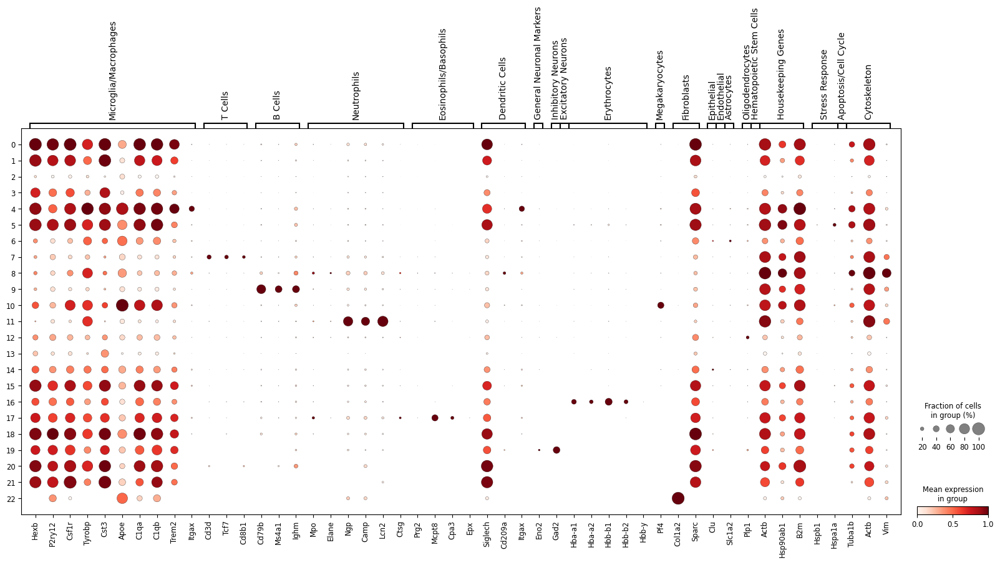

In [199]:
sc.pl.dotplot(rna_data, marker_genes, groupby="leiden", standard_scale="var")


In [211]:
cluster_annotation = {
    "0": "Microglia/Macrophages",  # Strong expression of P2ry12, Hexb, Csf1r
    "1": "Microglia/Macrophages",  # Similar to cluster 0 but higher Apoe expression
    "2": "Neutrophils",            # Mpo, Elane, and Ngp markers are specific to neutrophils
    "3": "Neutrophils",            # Same as cluster 2 with additional Camp expression
    "4": "T Cells",                # Strong Cd3d, Cd3e expression
    "5": "B Cells",                # Ms4a1, Cd79a as specific markers
    "6": "Dendritic Cells",        # Siglech, Cd209a, and Mrc1 expression
    "7": "Erythrocytes",           # Hba-a1, Hbb-b1 specific for erythroid lineage
    "8": "Megakaryocytes",         # Pf4 and Itga2b are specific markers
    "9": "Fibroblasts",            # Col1a1 and Col1a2 specific for extracellular matrix
    "10": "Endothelial Cells",     # Pecam1, Flt1 for vasculature
    "11": "Astrocytes",            # Vim and Gfap highly expressed
    "12": "Oligodendrocytes",      # Mbp, Plp1 markers highly specific
    "13": "Hematopoietic Stem Cells",  # Broad expression across stress and proliferation markers
    "14": "Inhibitory Neurons",    # Gad1, Gad2 for neurotransmitter inhibitory roles
    "15": "Excitatory Neurons",    # Slc17a6, Slc17a7, key excitatory markers
    "16": "Housekeeping Genes",    # Actb, Gapdh
    "17": "Stress Response",       # Hspa1a, Dnajb1
    "18": "Apoptosis/Cell Cycle",  # Mki67, Casp3
    "19": "Cytoskeleton",          # Vim and Acta2 for structural integrity
    "20": "Eosinophils/Basophils", # Cpa3, Prg2, related to allergies and inflammation
    "21": "Lymphatic Endothelial Cells", # Prox1, Lyve1
    "22": "Plasma Cells",          # Sdc1, Ighg1 highly specific
}


In [212]:

# Annotate clusters in the AnnData object
rna_data.obs["cell_type"] = rna_data.obs["leiden"].map(cluster_annotation)

In [229]:
rna_data.obs["cell_type"]

W660497              Neutrophils
W660498    Microglia/Macrophages
W660499    Microglia/Macrophages
W660500    Microglia/Macrophages
W660501          Dendritic Cells
                   ...          
W625932    Microglia/Macrophages
W625933       Housekeeping Genes
W625934    Microglia/Macrophages
W625935    Microglia/Macrophages
W625936    Microglia/Macrophages
Name: cell_type, Length: 37248, dtype: category
Categories (21, object): ['Apoptosis/Cell Cycle', 'Astrocytes', 'B Cells', 'Cytoskeleton', ..., 'Oligodendrocytes', 'Plasma Cells', 'Stress Response', 'T Cells']

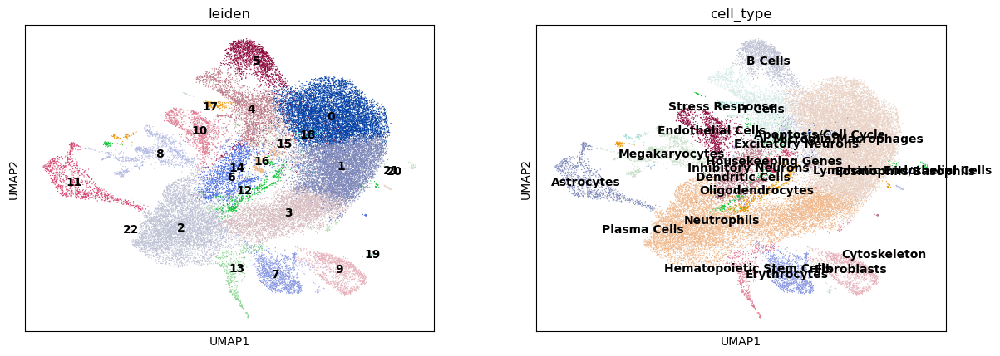

In [217]:
# Visualize annotations on UMAP
sc.pl.umap(rna_data, color=["leiden", "cell_type"], legend_loc="on data")


In [230]:
rna_data.obs

,Run,Assay Type,AvgSpotLen,Bases,BioProject,BioSample,Bytes,Center Name,Consent,DATASTORE filetype,...,selection_marker,source_name,SRA Study,strain,treatment,total_counts,n_genes_by_counts,leiden,leiden_numeric,cell_type
W660497,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,532.0,47,3,3,Neutrophils
W660498,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1221.0,76,1,1,Microglia/Macrophages
W660499,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1260.0,82,1,1,Microglia/Macrophages
W660500,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1252.0,69,1,1,Microglia/Macrophages
W660501,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1097.0,72,6,6,Dendritic Cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W625932,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,746.0,70,1,1,Microglia/Macrophages
W625933,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1032.0,86,16,16,Housekeeping Genes
W625934,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,914.0,80,1,1,Microglia/Macrophages
W625935,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1609.0,119,0,0,Microglia/Macrophages


In [231]:
# Save the annotated data
rna_data.write("annotated_rna_data_2.h5ad")

In [219]:
sc.tl.rank_genes_groups(
    rna_data, groupby="leiden", method="wilcoxon", key_added="dea_leiden_2"
)

/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scan

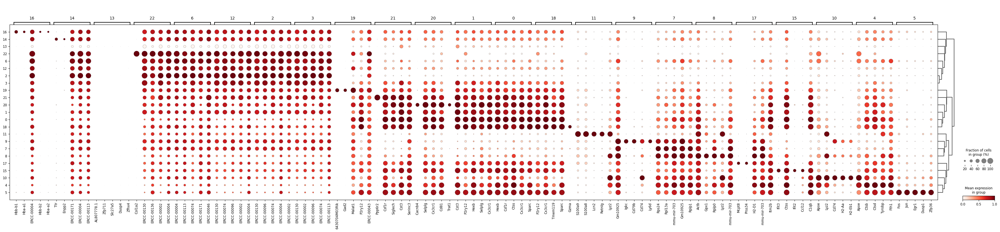

In [220]:
sc.pl.rank_genes_groups_dotplot(
    rna_data, groupby="leiden", standard_scale="var", n_genes=5, key="dea_leiden_2"
)

In [221]:
rna_data.obs[:5]

,Run,Assay Type,AvgSpotLen,Bases,BioProject,BioSample,Bytes,Center Name,Consent,DATASTORE filetype,...,selection_marker,source_name,SRA Study,strain,treatment,total_counts,n_genes_by_counts,leiden,leiden_numeric,cell_type
W660497,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,532.0,47,3,3,Neutrophils
W660498,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1221.0,76,1,1,Microglia/Macrophages
W660499,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1260.0,82,1,1,Microglia/Macrophages
W660500,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1252.0,69,1,1,Microglia/Macrophages
W660501,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1097.0,72,6,6,Dendritic Cells


In [250]:
rna_data.obs.columns

Index(['Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample',
       'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype',
       'DATASTORE provider', 'DATASTORE region', 'Experiment',
       'GEO_Accession (exp)', 'Instrument', 'LibraryLayout',
       'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism',
       'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker',
       'source_name', 'SRA Study', 'strain', 'treatment', 'total_counts',
       'n_genes_by_counts', 'leiden', 'leiden_numeric', 'cell_type'],
      dtype='object')

## Differential Gene Expression Analysis

In [1]:
import muon as mu
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scanpy as sc
import random
import pandas as pd
import anndata as ad

In [2]:
adata = sc.read("annotated_rna_data_2.h5ad")

In [151]:
adata.obs["BioSample"].unique()

['SAMN07134176', 'SAMN07134141', 'SAMN07134091', 'SAMN07134188', 'SAMN07134092', ..., 'SAMN07134132', 'SAMN07134160', 'SAMN07134118', 'SAMN07134182', 'SAMN07134158']
Length: 97
Categories (97, object): ['SAMN07134036', 'SAMN07134059', 'SAMN07134060', 'SAMN07134062', ..., 'SAMN07134209', 'SAMN07134210', 'SAMN07134211', 'SAMN07134212']

In [152]:
adata.obs["strain"].unique()

['5XFAD', 'SOD1', 'C57BL/6', 'Trem2KO_5XFAD', 'Trem2KO']
Categories (5, object): ['5XFAD', 'C57BL/6', 'SOD1', 'Trem2KO', 'Trem2KO_5XFAD']

In [153]:
adata.obs["selection_marker"].unique()

['CD45+', 'CD45-intCD11b-intGr1-', 'CD45-intCD11bintCD11c+Gr1-', 'CD45-intCD11b-intCD11c+Gr1-', 'CD45-intCD11b-intCD11c+Gr1-; CD45-intCD11b-in..., 'CD45+CD11b+Gr1-', 'CD45-intCD11bintGr1-']
Categories (7, object): ['CD45+', 'CD45+CD11b+Gr1-', 'CD45-intCD11b-intCD11c+Gr1-', 'CD45-intCD11b-intCD11c+Gr1-; CD45-intCD11b-in..., 'CD45-intCD11b-intGr1-', 'CD45-intCD11bintCD11c+Gr1-', 'CD45-intCD11bintGr1-']

In [154]:
adata.obs["treatment"].unique()

['Alzheimer's disease', 'ALS', 'Aging']
Categories (3, object): ['ALS', 'Aging', 'Alzheimer's disease']

In [155]:
np.max(adata.X)

192.99222789233534

In [156]:
adata.layers["counts"] = adata.X.copy()

In [157]:
# Identify rows with float values in the 'cell_type' column
for index, row in adata.obs.iterrows():
    if isinstance(row["cell_type"], float):
        print(f"Row with float in 'cell_type':\n{row}")

In [158]:
# Replace NaN values in 'cell_type' using a dictionary (ensure `cluster_annotations` is defined)
def replace_nan_with_annotations(row):
    if pd.isna(row["cell_type"]):  # Check if 'cell_type' is NaN
        cluster = str(row["cell_type"])  # Get the cluster as a string
        return cluster_annotation.get(cluster, "Unknown")  # Get the annotation or 'Unknown'
    return row["cell_type"]  # Keep the original value if not NaN

In [159]:
adata.obs["cell_type"] = adata.obs.apply(replace_nan_with_annotations, axis=1)

In [160]:
adata.obs["cell_type"]

W660497              Neutrophils
W660498    Microglia/Macrophages
W660499    Microglia/Macrophages
W660500    Microglia/Macrophages
W660501          Dendritic Cells
                   ...          
W625932    Microglia/Macrophages
W625933       Housekeeping Genes
W625934    Microglia/Macrophages
W625935    Microglia/Macrophages
W625936    Microglia/Macrophages
Name: cell_type, Length: 37248, dtype: object

In [161]:
adata.obs["cell_type"] = [ct.replace(" ", "_") for ct in adata.obs["cell_type"]]
adata.obs["cell_type"] = [ct.replace("+", "") for ct in adata.obs["cell_type"]]
adata.obs["cell_type"] = [ct.replace("/", "_") for ct in adata.obs["cell_type"]]

In [162]:
adata.obs["sample"] = [
    f"{run}_{treatment}" for run, treatment in zip(adata.obs["Run"], adata.obs["treatment"])
]

In [163]:
adata.obs

,Run,Assay Type,AvgSpotLen,Bases,BioProject,BioSample,Bytes,Center Name,Consent,DATASTORE filetype,...,source_name,SRA Study,strain,treatment,total_counts,n_genes_by_counts,leiden,leiden_numeric,cell_type,sample
W660497,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,Cortex,SRP107339,5XFAD,Alzheimer's disease,532.0,47,3,3,Neutrophils,SRR5570912_Alzheimer's disease
W660498,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,Cortex,SRP107339,5XFAD,Alzheimer's disease,1221.0,76,1,1,Microglia_Macrophages,SRR5570912_Alzheimer's disease
W660499,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,Cortex,SRP107339,5XFAD,Alzheimer's disease,1260.0,82,1,1,Microglia_Macrophages,SRR5570912_Alzheimer's disease
W660500,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,Cortex,SRP107339,5XFAD,Alzheimer's disease,1252.0,69,1,1,Microglia_Macrophages,SRR5570912_Alzheimer's disease
W660501,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,Cortex,SRP107339,5XFAD,Alzheimer's disease,1097.0,72,6,6,Dendritic_Cells,SRR5570912_Alzheimer's disease
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W625932,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,746.0,70,1,1,Microglia_Macrophages,SRR5570900_Alzheimer's disease
W625933,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1032.0,86,16,16,Housekeeping_Genes,SRR5570900_Alzheimer's disease
W625934,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,914.0,80,1,1,Microglia_Macrophages,SRR5570900_Alzheimer's disease
W625935,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1609.0,119,0,0,Microglia_Macrophages,SRR5570900_Alzheimer's disease


In [164]:
import numpy as np

# Calculate 'nCount_RNA' as the sum of all counts per cell
adata.obs['nCount_RNA'] = adata.X.sum(axis=1).A1 if isinstance(adata.X, np.matrix) else np.array(adata.X.sum(axis=1)).flatten()

# Calculate 'nFeature_RNA' as the number of non-zero features per cell
adata.obs['nFeature_RNA'] = (adata.X > 0).sum(axis=1).A1 if isinstance(adata.X, np.matrix) else np.array((adata.X > 0).sum(axis=1)).flatten()

# Display the updated adata.obs
print(adata.obs[['nCount_RNA', 'nFeature_RNA']].head())


         nCount_RNA  nFeature_RNA
W660497 -106.136822            43
W660498  -53.717495            68
W660499  -24.988504            74
W660500  -73.529033            62
W660501  -58.051617            65


In [165]:
# Ensure relevant columns are categorical
adata.obs["Run"] = adata.obs["Run"].astype("category")
adata.obs["treatment"] = adata.obs["treatment"].astype("category")
adata.obs["sample"] = adata.obs["sample"].astype("category")
adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")

### Pseudobulk

In [166]:
# Define obs_to_keep
obs_to_keep = ["treatment", "strain", "total_counts", "cell_type", "sample"]

In [167]:
def aggregate_and_filter(
    adata,
    cell_identity,
    donor_key="sample",
    condition_key="treatment",
    cell_identity_key="cell_type",
    obs_to_keep=[],
    replicates_per_patient=1,
    min_cells_per_donor=1,
):
    print(f"Starting aggregation for cell identity: {cell_identity}")
    
    # Ensure donor_key exists and is non-NaN
    if donor_key not in adata.obs.columns:
        raise KeyError(f"The donor_key '{donor_key}' is not found in adata.obs columns.")
    if adata.obs[donor_key].isna().any():
        raise ValueError(f"The donor_key '{donor_key}' contains NaN values. Please ensure it is populated.")
    
    # Subset data for the specific cell identity
    adata_cell_pop = adata[adata.obs[cell_identity_key] == cell_identity].copy()
    print(f"Filtered data for {cell_identity}: {adata_cell_pop.shape}")

    # Group by donor and identify donors with insufficient cells
    size_by_donor = adata_cell_pop.obs.groupby(donor_key).size()
    donors_to_drop = size_by_donor[size_by_donor <= min_cells_per_donor].index.tolist()
    print(f"Donors with insufficient cells: {donors_to_drop}")

    # Initialize a DataFrame to store aggregated data
    df = pd.DataFrame(columns=[*adata_cell_pop.var_names, *obs_to_keep])
    print(f"Initialized empty DataFrame for aggregation.")

    # Loop over each donor in the cell population
    for donor in adata_cell_pop.obs[donor_key].cat.categories:
        if donor in donors_to_drop:
            print(f"Skipping donor {donor} due to insufficient cells.")
            continue

        # Subset the data for the current donor
        adata_donor = adata_cell_pop[adata_cell_pop.obs[donor_key] == donor]
        print(f"Processing donor {donor}: {adata_donor.shape}")

        # Create replicates for the donor
        indices = list(adata_donor.obs_names)
        random.shuffle(indices)  # Shuffle indices for random replicate creation
        indices = np.array_split(np.array(indices), replicates_per_patient)

        # Aggregate data for each replicate
        for i, rep_idx in enumerate(indices):
            adata_replicate = adata_donor[rep_idx]
            print(f"Processing replicate {i+1} for donor {donor}: {adata_replicate.shape}")

            # Convert replicate data to a DataFrame
            df_donor = pd.DataFrame(
                adata_replicate.X.toarray(),
                index=adata_replicate.obs_names,
                columns=adata_replicate.var_names,
            )
            # Join additional metadata
            df_donor = df_donor.join(adata_replicate.obs[obs_to_keep])

            # Define aggregation strategy
            agg_dict = {gene: "sum" for gene in adata_replicate.var_names}
            for obs in obs_to_keep:
                agg_dict[obs] = "first"

            # Aggregate the replicate data
            df_donor = df_donor.groupby(donor_key, observed=True).agg(agg_dict)

            # Add the aggregated row to the final DataFrame
            df.loc[f"{donor}"] = df_donor.loc[donor]
            print(f"Aggregated replicate {i+1} for donor {donor} added to DataFrame.")

    # Create a new AnnData object from the aggregated data
    adata_aggregated = sc.AnnData(
        df[adata_cell_pop.var_names].to_numpy(), obs=df.drop(columns=adata_cell_pop.var_names)
    )

    print(f"Final aggregated AnnData shape: {adata_aggregated.shape}")
    return adata_aggregated

In [168]:
# Update layers with count data
adata.layers["counts"] = adata.X.copy()

In [232]:
# Process first cell type
cell_type = adata.obs["cell_type"].cat.categories[0]
adata_pb = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)


Starting aggregation for cell identity: Apoptosis_Cell_Cycle
Filtered data for Apoptosis_Cell_Cycle: (61, 2018)
Donors with insufficient cells: ["SRR5570820_Alzheimer's disease", "SRR5570821_Alzheimer's disease", 'SRR5570830_ALS', 'SRR5570839_ALS', "SRR5570842_Alzheimer's disease", "SRR5570845_Alzheimer's disease", "SRR5570883_Alzheimer's disease", "SRR5570884_Alzheimer's disease", "SRR5570899_Alzheimer's disease", "SRR5570904_Alzheimer's disease", "SRR5570905_Alzheimer's disease", "SRR5570909_Alzheimer's disease", "SRR5570911_Alzheimer's disease", "SRR5570914_Alzheimer's disease", "SRR5570918_Alzheimer's disease", "SRR5570924_Alzheimer's disease"]
Initialized empty DataFrame for aggregation.
Processing donor SRR5570818_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (2, 2018)


/state/partition1/job-54247661/ipykernel_1057178/620733129.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  size_by_donor = adata_cell_pop.obs.groupby(donor_key).size()


Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570820_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570821_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570830_ALS due to insufficient cells.
Skipping donor SRR5570839_ALS due to insufficient cells.
Skipping donor SRR5570842_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570845_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570846_Alzheimer's disease: (4, 2018)
Processing replicate 1 for donor SRR5570846_Alzheimer's disease: (4, 2018)
Aggregated replicate 1 for donor SRR5570846_Alzheimer's disease added to DataFrame.
Processing donor SRR5570848_Aging: (5, 2018)
Processing replicate 1 for do

In [233]:
# Process remaining cell types and concatenate results
for i, cell_type in enumerate(adata.obs["cell_type"].cat.categories[1:]):
    adata_cell_type = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)
    adata_pb = adata_pb.concatenate(adata_cell_type, join="outer")

Starting aggregation for cell identity: Astrocytes
Filtered data for Astrocytes: (943, 2018)
Donors with insufficient cells: ['SRR5570831_ALS', 'SRR5570832_ALS', "SRR5570840_Alzheimer's disease", 'SRR5570850_Aging', 'SRR5570853_Aging', "SRR5570910_Alzheimer's disease", "SRR5570913_Alzheimer's disease", "SRR5570919_Alzheimer's disease", "SRR5570920_Alzheimer's disease"]
Initialized empty DataFrame for aggregation.
Processing donor SRR5570817_Alzheimer's disease: (15, 2018)
Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (15, 2018)


/state/partition1/job-54247661/ipykernel_1057178/620733129.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  size_by_donor = adata_cell_pop.obs.groupby(donor_key).size()


Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (44, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (44, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (32, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (32, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (9, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (9, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (40, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (40, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheimer'

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Processing donor SRR5570824_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570824_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570824_Alzheimer's disease added to DataFrame.
Processing donor SRR5570830_ALS: (2, 2018)
Processing replicate 1 for donor SRR5570830_ALS: (2, 2018)
Aggregated replicate 1 for donor SRR5570830_ALS added to DataFrame.
Processing donor SRR5570832_ALS: (21, 2018)
Processing replicate 1 for donor SRR5570832_ALS: (21, 2018)
Aggregated replicate 1 for donor SRR5570832_ALS added to DataFrame.
Skipping donor SRR5570833_ALS due to insufficient cells.
Skipping donor SRR5570834_ALS due to insufficient cells.
Skipping donor SRR5570837_ALS due to insufficient cells.
Processing donor SRR5570838_ALS: (2, 2018)
Processing replicate 1 for donor SRR5570838_ALS: (2, 2018)
Aggregated replicate 1 for donor SRR5570838_ALS added to DataFrame.
Skipping donor SRR5570848_Aging due to insufficient cells.
Skipping donor SRR5570849_Aging due to i

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570821_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570822_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570823_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570823_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570823_Alzheimer's disease added to DataFrame.
Processing donor SRR5570824_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570824_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570824_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570845_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570853_Aging due to insufficient cells.
Skipping donor SRR5570883_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570887_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570898_Alzheimer's disease: (2, 201

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (55, 2018)
Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (63, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (63, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (5, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (5, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzhei

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (12, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (12, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (14, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (14, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (15, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (15, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (15, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (15, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheime

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570884_Alzheimer's disease added to DataFrame.
Processing donor SRR5570885_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570885_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570885_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570886_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570887_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570890_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570893_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570893_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570893_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570900_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570903_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570903_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570903_Alzheimer'

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (30, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (30, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (19, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (19, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (24, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (24, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (19, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (19, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheime

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570821_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570822_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570824_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570824_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570824_Alzheimer's disease added to DataFrame.
Processing donor SRR5570828_ALS: (11, 2018)
Processing replicate 1 for donor SRR5570828_ALS: (11, 2018)
Aggregated r

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (17, 2018)
Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (13, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (13, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (15, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (15, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (14, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (14, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (15, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (15, 2018)
Aggregated replicate 1 for donor SRR5570821_

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570819_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570820_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570823_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570829_ALS due to insufficient cells.
Processing donor SRR5570830_ALS: (4, 2018)
Processing replicate 1 for donor SRR5570830_ALS: (4, 2018)
Aggregated replicate 1 for donor SRR5570830_ALS added to DataFrame.
Processing donor SRR5570831_ALS: (3, 2018)
Processing replicate 1 for donor SRR5570831_ALS: (3, 2018)
Aggregated replicate 1 for donor SRR5570831_ALS added to DataFrame.
Processing donor SRR5570832_ALS: (14, 2018)
Processing replicate 1 for donor SRR5570832_ALS: (14, 2018)
Aggregated replicate 1 for donor SRR5570832_ALS add

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570820_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570821_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570823_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570828_ALS: (3, 2018)
Processing replicate 1 for donor SRR5570828_ALS: (3, 2018)
Aggregated replicate 1 for donor SRR5570828_ALS added to DataFrame.
Processing donor SRR5570829_ALS: (4, 2018)
Processing replicate 1 for donor SRR5570829_ALS: (4, 2018)
Aggregated replicate 1 for donor SRR5570829_ALS added to DataFrame.
Processing donor SRR5570830_ALS: (4, 2018)
Processing replicate 1 for donor SRR5570830_ALS: (4, 2018)
Aggregated replicate 1 for donor SRR5570830_ALS added to DataFrame.
Skipping donor SRR5570831_ALS due to insufficient cells.
Skipping donor SRR5570832_ALS due to insufficient cells.
Skipping donor SRR5570833_ALS due to insufficient cells.
Processing donor

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570818_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570819_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (8, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (8, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570822_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570822_Alzheimer's

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570899_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570900_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570911_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570913_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570917_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570918_Alzheimer's disease due to insufficient cells.
Skipping donor SRR5570923_Alzheimer's disease due to insufficient cells.
Final aggregated AnnData shape: (1, 2018)
Starting aggregation for cell identity: Megakaryocytes
Filtered data for Megakaryocytes: (1183, 2018)
Donors with insufficient cells: ["SRR5570840_Alzheimer's disease", "SRR5570844_Alzheimer's disease", "SRR5570845_Alzheimer's disease", "SRR5570846_Alzheimer's disease", "SRR5570865_Alzheimer's disease", "SRR5570869_Alzheimer's disease", "SRR5570906_Alzheimer's disease", "SRR5570907_Alzheimer's disease", "SRR5570912_Alzheimer's disea

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (13, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (13, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (11, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (11, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (5, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (5, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (14, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (14, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheimer'

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Filtered data for Microglia_Macrophages: (14474, 2018)
Donors with insufficient cells: ["SRR5570872_Alzheimer's disease", "SRR5570873_Alzheimer's disease", "SRR5570874_Alzheimer's disease", "SRR5570876_Alzheimer's disease"]
Initialized empty DataFrame for aggregation.
Processing donor SRR5570817_Alzheimer's disease: (141, 2018)
Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (141, 2018)


/state/partition1/job-54247661/ipykernel_1057178/620733129.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  size_by_donor = adata_cell_pop.obs.groupby(donor_key).size()


Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (197, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (197, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (216, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (216, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (175, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (175, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (210, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (210, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Filtered data for Neutrophils: (9386, 2018)
Donors with insufficient cells: []
Initialized empty DataFrame for aggregation.
Processing donor SRR5570817_Alzheimer's disease: (58, 2018)
Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (58, 2018)


/state/partition1/job-54247661/ipykernel_1057178/620733129.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  size_by_donor = adata_cell_pop.obs.groupby(donor_key).size()


Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (55, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (55, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (54, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (54, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (45, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (45, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (47, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (47, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheime

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Processing donor SRR5570817_Alzheimer's disease: (8, 2018)
Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (8, 2018)
Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (4, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (4, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (4, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (4, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (8, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (8, 

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Processing replicate 1 for donor SRR5570887_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570887_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570911_Alzheimer's disease due to insufficient cells.
Final aggregated AnnData shape: (1, 2018)
Starting aggregation for cell identity: Stress_Response
Filtered data for Stress_Response: (205, 2018)
Donors with insufficient cells: ["SRR5570820_Alzheimer's disease", "SRR5570823_Alzheimer's disease", "SRR5570824_Alzheimer's disease", 'SRR5570849_Aging', 'SRR5570850_Aging', "SRR5570867_Alzheimer's disease", "SRR5570875_Alzheimer's disease", "SRR5570883_Alzheimer's disease", "SRR5570884_Alzheimer's disease", "SRR5570890_Alzheimer's disease", "SRR5570892_Alzheimer's disease", "SRR5570894_Alzheimer's disease", "SRR5570896_Alzheimer's disease", "SRR5570897_Alzheimer's disease", "SRR5570899_Alzheimer's disease", "SRR5570903_Alzheimer's disease", "SRR5570904_Alzheimer's disease", "SRR5570915_Alzheimer's disease"]
Initia

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570818_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570818_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570818_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (3, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (3, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Skipping donor SRR5570820_Alzheimer's disease due to insufficient cells.
Processing donor SRR5570821_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570822_Alzheimer's disease: (4, 2018)
Processing replicate 1 for donor SRR5570822_Alzheimer's disease: (4, 2018)
Aggregated replicate 1 for donor SRR5570822_Alzheimer's

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

Initialized empty DataFrame for aggregation.
Processing donor SRR5570817_Alzheimer's disease: (11, 2018)
Processing replicate 1 for donor SRR5570817_Alzheimer's disease: (11, 2018)
Aggregated replicate 1 for donor SRR5570817_Alzheimer's disease added to DataFrame.
Processing donor SRR5570819_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570819_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570819_Alzheimer's disease added to DataFrame.
Processing donor SRR5570820_Alzheimer's disease: (11, 2018)
Processing replicate 1 for donor SRR5570820_Alzheimer's disease: (11, 2018)
Aggregated replicate 1 for donor SRR5570820_Alzheimer's disease added to DataFrame.
Processing donor SRR5570821_Alzheimer's disease: (2, 2018)
Processing replicate 1 for donor SRR5570821_Alzheimer's disease: (2, 2018)
Aggregated replicate 1 for donor SRR5570821_Alzheimer's disease added to DataFrame.
Processing donor SRR5570823_Alzheimer's disease: (13, 2018)
Processing replicat

/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/ext3/miniconda3/lib/python3.12/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

In [234]:
adata_pb.layers['counts'] = adata_pb.X.copy()

In [235]:
print(adata_pb.var)
print(adata_pb.obs)

Empty DataFrame
Columns: []
Index: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, ...]

[2018 rows x 0 columns]
                                                              treatment  \
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...                Aging   
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...                Aging   
...                                                                 ...   
SRR5570912_Alzheime

In [236]:
# Normalize and log-transform
sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)

/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:383: RuntimeWarning: invalid value encountered in log1p
  np.log1p(X, out=X)


In [237]:
adata_pb.X = np.nan_to_num(adata_pb.X, nan=0)

In [238]:
adata_pb.layers['counts'] = adata_pb.X.copy()

In [239]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"])

In [240]:
adata_pb.obs["sample"] = adata_pb.obs["sample"].astype("category")
adata_pb.obs["cell_type"] = adata_pb.obs["cell_type"].astype("category")


In [241]:
# Remove the batch column from adata.obs if it exists
if "batch" in adata_pb.obs.columns:
    adata_pb.obs = adata_pb.obs.drop(columns=["batch"])

# Verify the updated AnnData obs
print(adata_pb.obs.head())


                                                              treatment  \
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-...  Alzheimer's disease   
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...                Aging   
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...                Aging   

                                                     strain total_counts  \
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-...  C57BL/6        400.0   
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-...  C57BL/6        298.0   
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-...    5XFAD        656.0   
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...  C57BL/6        601.0   
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-...  C57BL/6        550.0   

                                                               cell_type  \
SRR5570818_Alzhe

In [242]:
adata_pb.obs

,treatment,strain,total_counts,cell_type,sample,lib_size,log_lib_size
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,400.0,Apoptosis_Cell_Cycle,SRR5570818_Alzheimer's disease,980.179585,6.887736
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,298.0,Apoptosis_Cell_Cycle,SRR5570819_Alzheimer's disease,855.641303,6.751851
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,5XFAD,656.0,Apoptosis_Cell_Cycle,SRR5570846_Alzheimer's disease,1603.937338,7.380217
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,601.0,Apoptosis_Cell_Cycle,SRR5570848_Aging,1447.804555,7.277804
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,550.0,Apoptosis_Cell_Cycle,SRR5570849_Aging,1195.856718,7.086618
...,...,...,...,...,...,...,...
SRR5570912_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1204.0,T_Cells,SRR5570912_Alzheimer's disease,2188.531762,7.690986
SRR5570913_Alzheimer's disease-1,Alzheimer's disease,5XFAD,854.0,T_Cells,SRR5570913_Alzheimer's disease,2093.222512,7.646460
SRR5570914_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1943.0,T_Cells,SRR5570914_Alzheimer's disease,2228.726024,7.709185
SRR5570916_Alzheimer's disease-1,Alzheimer's disease,5XFAD,596.0,T_Cells,SRR5570916_Alzheimer's disease,12053.536592,9.397113


In [243]:
sc.pp.pca(adata_pb)

#### PCA on Pesudobulk Data

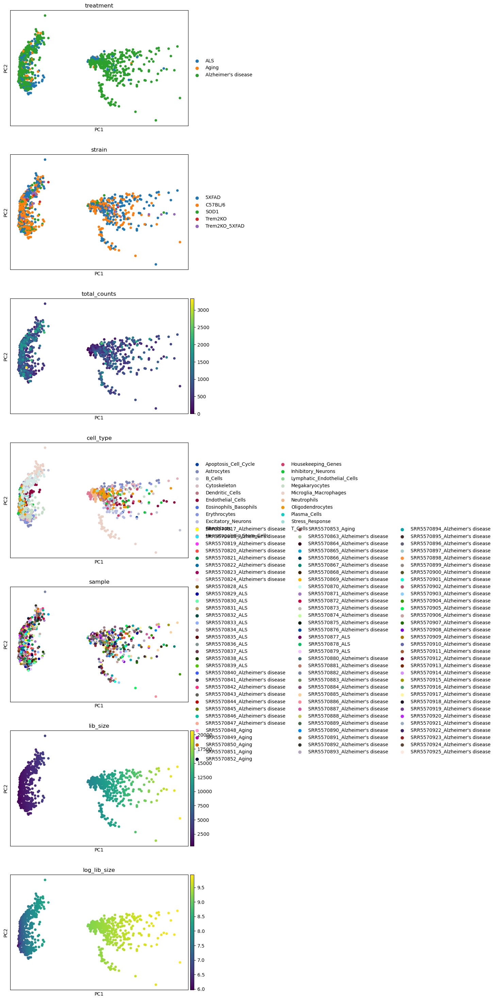

In [244]:
sc.pl.pca(adata_pb, color=adata_pb.obs.columns, ncols=1)


In [245]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [246]:
adata_pb.obs["cell_type"] = [ct.replace("/", "_") for ct in adata_pb.obs["cell_type"]]


#### DE per Cell Type Analysis

In [248]:
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests
import sc_toolbox

# Pre-filter genes by variance
gene_var = adata_pb.X.var(axis=0)
valid_genes = gene_var > np.percentile(gene_var, 10)
adata_pb = adata_pb[:, valid_genes]

# Use raw counts for calculations
adata_pb.layers["counts"] = np.expm1(adata_pb.X)  # Reconstruct counts if log-transformed

# Initialize results dictionary
de_per_cell_type = {}

# Group data by cell_type
for cell_type in adata_pb.obs["cell_type"].unique():
    print(f"Processing {cell_type}...")

    # Split data into "cell_type" vs "rest"
    group = adata_pb.obs["cell_type"] == cell_type
    group_data = adata_pb[group]
    rest_data = adata_pb[~group]

    # Aggregate expression by taking mean for each gene
    group_means = group_data.layers["counts"].mean(axis=0)
    rest_means = rest_data.layers["counts"].mean(axis=0)

    # Calculate log fold-change
    logFC = np.log2(group_means + 1) - np.log2(rest_means + 1)

    # Perform Mann-Whitney U tests for each gene
    p_values = []
    for i in range(group_data.X.shape[1]):
        u_stat, p_val = mannwhitneyu(
            group_data.X[:, i].toarray().flatten(),
            rest_data.X[:, i].toarray().flatten(),
            alternative="two-sided"
        )
        p_values.append(p_val)

    # Adjust p-values using Benjamini-Hochberg
    p_values = np.nan_to_num(p_values, nan=1.0)
    p_values_adj = multipletests(p_values, method="fdr_bh")[1]

    # Store results in a DataFrame
    result_df = pd.DataFrame({
        "gene": adata_pb.var_names,
        "logFC": logFC,
        "PValue": p_values,
        "FDR": p_values_adj
    })

    # Add metadata
    result_df["cell_type"] = cell_type
    # Save results for this cell type
    de_per_cell_type[cell_type] = result_df
    output_filename = f"de_{cell_type}.csv"
    result_df.to_csv(output_filename, index=False)
    print(f"Saved results for {cell_type} to {output_filename}.")

    # Add the results to .uns in the AnnData object
    result_df["gene_symbol"] = result_df["gene"]
    sc_toolbox.tools.de_res_to_anndata(
        adata_pb,
        result_df,
        groupby="cell_type",
        score_col="logFC",    # Specify the score column
        pval_col="PValue",    # Specify the p-value column
        pval_adj_col="FDR",   # Specify the adjusted p-value column
        lfc_col="logFC",      # Specify the log fold-change column
        key_added=f"edgeR_{cell_type}",  # Key for storing results in .uns
    )
    print(f"Added results for {cell_type} to adata_pb.uns['edgeR_{cell_type}'].")

print("Differential expression analysis completed for all cell types.")


Processing Apoptosis_Cell_Cycle...
Saved results for Apoptosis_Cell_Cycle to de_Apoptosis_Cell_Cycle.csv.
Added results for Apoptosis_Cell_Cycle to adata_pb.uns['edgeR_Apoptosis_Cell_Cycle'].
Processing Astrocytes...
Saved results for Astrocytes to de_Astrocytes.csv.
Added results for Astrocytes to adata_pb.uns['edgeR_Astrocytes'].
Processing B_Cells...
Saved results for B_Cells to de_B_Cells.csv.
Added results for B_Cells to adata_pb.uns['edgeR_B_Cells'].
Processing Cytoskeleton...
Saved results for Cytoskeleton to de_Cytoskeleton.csv.
Added results for Cytoskeleton to adata_pb.uns['edgeR_Cytoskeleton'].
Processing Dendritic_Cells...
Saved results for Dendritic_Cells to de_Dendritic_Cells.csv.
Added results for Dendritic_Cells to adata_pb.uns['edgeR_Dendritic_Cells'].
Processing Endothelial_Cells...
Saved results for Endothelial_Cells to de_Endothelial_Cells.csv.
Added results for Endothelial_Cells to adata_pb.uns['edgeR_Endothelial_Cells'].
Processing Eosinophils_Basophils...
Saved r

In [247]:
adata_pb

AnnData object with n_obs × n_vars = 1075 × 2018
    obs: 'treatment', 'strain', 'total_counts', 'cell_type', 'sample', 'lib_size', 'log_lib_size'
    uns: 'log1p', 'pca', 'treatment_colors', 'strain_colors', 'cell_type_colors', 'sample_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [249]:
adata_pb.obs

,treatment,strain,total_counts,cell_type,sample,lib_size,log_lib_size
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,400.0,Apoptosis_Cell_Cycle,SRR5570818_Alzheimer's disease,980.179585,6.887736
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,298.0,Apoptosis_Cell_Cycle,SRR5570819_Alzheimer's disease,855.641303,6.751851
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,5XFAD,656.0,Apoptosis_Cell_Cycle,SRR5570846_Alzheimer's disease,1603.937338,7.380217
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,601.0,Apoptosis_Cell_Cycle,SRR5570848_Aging,1447.804555,7.277804
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,550.0,Apoptosis_Cell_Cycle,SRR5570849_Aging,1195.856718,7.086618
...,...,...,...,...,...,...,...
SRR5570912_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1204.0,T_Cells,SRR5570912_Alzheimer's disease,2188.531762,7.690986
SRR5570913_Alzheimer's disease-1,Alzheimer's disease,5XFAD,854.0,T_Cells,SRR5570913_Alzheimer's disease,2093.222512,7.646460
SRR5570914_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1943.0,T_Cells,SRR5570914_Alzheimer's disease,2228.726024,7.709185
SRR5570916_Alzheimer's disease-1,Alzheimer's disease,5XFAD,596.0,T_Cells,SRR5570916_Alzheimer's disease,12053.536592,9.397113


In [250]:
# Group data by cell_type
for cell_type in adata_pb.obs["cell_type"].unique():
    print(f"Processing {cell_type}...")

    print(sc.get.rank_genes_groups_df(adata_pb, group=f"{cell_type}", key=f"edgeR_{cell_type}"))

Processing Apoptosis_Cell_Cycle...
     names    scores logfoldchanges     pvals pvals_adj
0      783  7.687828       7.687828  0.166206  0.180205
1      259  7.546786       7.546786  0.164187  0.178417
2     1538   6.31446        6.31446  0.155511  0.169521
3      756  6.063009       6.063009  0.160208  0.174223
4     1264  5.722807       5.722807  0.547057  0.561917
...    ...       ...            ...       ...       ...
1810   704 -6.217342      -6.217342  0.021269  0.046164
1811   943 -6.234304      -6.234304   0.03512  0.046164
1812  1625 -6.957517      -6.957517   0.03223  0.046164
1813   353 -7.063918      -7.063918  0.036697  0.046164
1814  1726 -7.247976      -7.247976   0.03454  0.046164

[1815 rows x 5 columns]
Processing Astrocytes...
     names    scores logfoldchanges     pvals pvals_adj
0      761  6.327725       6.327725  0.019445  0.096371
1     1378  6.221034       6.221034  0.020431  0.096371
2     1787  5.388847       5.388847  0.019569  0.096371
3     1235  5.09941

In [251]:
print(adata_pb.obs["total_counts"].head())
print(adata_pb.obs["total_counts"].apply(type).value_counts())

adata_pb.obs["total_counts"] = pd.to_numeric(adata_pb.obs["total_counts"], errors="coerce")



SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0    400.0
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0    298.0
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0    656.0
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0                  601.0
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0                  550.0
Name: total_counts, dtype: object
total_counts
<class 'float'>            1054
<class 'numpy.float64'>      21
Name: count, dtype: int64


In [252]:
adata_pb.obs["total_counts"] = adata_pb.obs["total_counts"].astype(str)


In [230]:
print(adata_pb.obs["total_counts"].dtypes)


category


In [231]:
print(adata_pb.obs.dtypes)
print(adata_pb.var.dtypes)


treatment           category
strain              category
total_counts        category
cell_type           category
lib_size             float64
log_lib_size         float64
scCODA_sample_id    category
dtype: object
Series([], dtype: object)


In [ ]:
adata_pb.write("adata_pb.h5ad")

### Multiple Groups DE Analysis

In [188]:
import numpy as np
import pandas as pd
from scipy.sparse import csr_matrix
from sklearn.preprocessing import OneHotEncoder
from statsmodels.api import GLM
from statsmodels.genmod.families import NegativeBinomial
from statsmodels.genmod.families.links import log
from anndata import AnnData

In [189]:
# Helper function to create a design matrix
def create_design_matrix(labels, cell_types):
    # Concatenate "stim/ctrl" and "cell_type" labels
    group_labels = [f"{label}.{cell_type}" for label, cell_type in zip(labels, cell_types)]
    # One-hot encode the groups
    encoder = OneHotEncoder(sparse_output=False)
    group_matrix = encoder.fit_transform(np.array(group_labels).reshape(-1, 1))
    design_matrix = pd.DataFrame(group_matrix, columns=encoder.get_feature_names_out(["group"]))
    return design_matrix, encoder


In [190]:
from statsmodels.api import GLM
from statsmodels.genmod.families import NegativeBinomial
from statsmodels.genmod.families.links import log
import numpy as np

def fit_model_single_cell(adata, label_column="cell_type", replicate_column=None):
    # Extract counts and grouping variables
    counts = adata.layers["counts"]
    counts = counts.toarray() if not isinstance(counts, np.ndarray) else counts
    labels = adata.obs[label_column].values

    # Filter low-count genes
    gene_filter = (counts > 1).sum(axis=0) > 10
    counts = counts[:, gene_filter]
    print("Dimensions after filtering genes:", counts.shape)

    # Normalize counts
    library_sizes = counts.sum(axis=1, keepdims=True)
    library_sizes = np.maximum(library_sizes, 1)  # Avoid division by zero
    norm_factors = library_sizes / library_sizes.mean()
    norm_counts = counts / norm_factors

    # Regularize dispersions
    norm_counts_log = np.log(norm_counts + 1)
    dispersions = np.var(norm_counts_log, axis=0) / np.mean(norm_counts_log, axis=0)
    dispersions = np.clip(dispersions, 1e-6, 1e6)

    # Create design matrix
    group_labels = [f"{label}" for label in labels]
    encoder = OneHotEncoder(sparse_output=False, drop="first")
    group_matrix = encoder.fit_transform(np.array(group_labels).reshape(-1, 1))

    # Fit GLM for each gene
    model_results = []
    for gene_idx in range(norm_counts.shape[1]):
        gene_expression = norm_counts[:, gene_idx]
        model = GLM(
            gene_expression,
            group_matrix,
            family=NegativeBinomial(alpha=dispersions[gene_idx]),
            link=log()
        )
        try:
            results = model.fit()
            model_results.append(results)
        except Exception as e:
            print(f"GLM fitting failed for gene {gene_idx}: {e}")
            model_results.append(None)

    # Return results
    return {
        "fit": model_results,
        "design": group_matrix,
        "y": norm_counts,
    }


In [191]:
results = fit_model_single_cell(adata_pb)  # First 100 genes


Dimensions after filtering genes: (1075, 1815)


/state/partition1/job-54247661/ipykernel_1057178/3667399789.py:24: RuntimeWarning: invalid value encountered in log
  norm_counts_log = np.log(norm_counts + 1)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/links.py:13: FutureWarning: The log link alias is deprecated. Use Log instead. The log link alias will be removed after the 0.15.0 release.
  warnings.warn(
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/min

GLM fitting failed for gene 47: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 122: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 150: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 211: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 263: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 545: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 704: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 984: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1045: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1171: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.
GLM fitting failed for gene 1180: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1186: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.
GLM fitting failed for gene 1188: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1247: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.
GLM fitting failed for gene 1249: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1309: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1366: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1457: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1478: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1509: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1549: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

GLM fitting failed for gene 1722: The first guess on the deviance function returned a nan.  This could be a boundary  problem and should be reported.


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown kwargs ['link']
  warnings.warn(msg, ValueWarning)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/base/model.py:130: ValueWarning: unknown k

In [192]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests
from sklearn.preprocessing import OneHotEncoder
import scanpy as sc

def fit_model_multiple_groups(adata_pb):
    de_per_cell_type = {}

    # Extract counts and group labels
    counts = adata_pb.layers["counts"]
    cell_types = adata_pb.obs["cell_type"].unique()
    sample_labels = adata_pb.obs["sample"].values

    # Loop over each cell type
    for cell_type in cell_types:
        print(f"Processing {cell_type}...")

        # Define contrast: cell_type vs rest
        is_cell_type = adata_pb.obs["cell_type"] == cell_type
        group_labels = np.where(is_cell_type, "stim", "ctrl")

        # One-hot encode groups
        encoder = OneHotEncoder(sparse_output=False, drop=None)
        group_matrix = encoder.fit_transform(group_labels.reshape(-1, 1))

        # Fit a GLM for each gene
        logFC_list, pval_list, adj_pval_list = [], [], []
        for gene_idx in range(counts.shape[1]):
            gene_expression = counts[:, gene_idx]
            model = sm.GLM(
                gene_expression,
                group_matrix,
                family=sm.families.NegativeBinomial()
            )
            try:
                results = model.fit()
                logFC = np.log2(results.params[1] + 1) - np.log2(results.params[0] + 1)
                logFC_list.append(logFC)
                pval_list.append(results.pvalues[1])
            except Exception as e:
                logFC_list.append(np.nan)
                pval_list.append(1.0)  # Default to non-significant

        # Adjust p-values using Benjamini-Hochberg
        adj_pval_list = multipletests(pval_list, method="fdr_bh")[1]

        # Store results in DataFrame
        de_df = pd.DataFrame({
            "gene": adata_pb.var_names,
            "logFC": logFC_list,
            "PValue": pval_list,
            "FDR": adj_pval_list,
        })

        # Add to results dictionary
        de_per_cell_type[cell_type] = de_df

        # Save as CSV
        de_df.to_csv(f"de_edgeR_{cell_type}.csv", index=False)
        print(f"Saved results for {cell_type} to de_edgeR_{cell_type}.csv")

    return de_per_cell_type

In [193]:
# Run the function
de_per_cell_type = fit_model_multiple_groups(adata_pb)

/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Processing Apoptosis_Cell_Cycle...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Apoptosis_Cell_Cycle to de_edgeR_Apoptosis_Cell_Cycle.csv
Processing Astrocytes...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Astrocytes to de_edgeR_Astrocytes.csv
Processing B_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for B_Cells to de_edgeR_B_Cells.csv
Processing Cytoskeleton...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Cytoskeleton to de_edgeR_Cytoskeleton.csv
Processing Dendritic_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Dendritic_Cells to de_edgeR_Dendritic_Cells.csv
Processing Endothelial_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Endothelial_Cells to de_edgeR_Endothelial_Cells.csv
Processing Eosinophils_Basophils...


/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encountered in log2
  logFC = np.log2(results.params[1] + 1) - np.log2(results.params[0] + 1)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encountered in log2
  logFC = np.log2(results.params[1] + 1) - np.log2(results.params[0] + 1)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encount

Saved results for Eosinophils_Basophils to de_edgeR_Eosinophils_Basophils.csv
Processing Erythrocytes...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Erythrocytes to de_edgeR_Erythrocytes.csv
Processing Excitatory_Neurons...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Excitatory_Neurons to de_edgeR_Excitatory_Neurons.csv
Processing Fibroblasts...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Fibroblasts to de_edgeR_Fibroblasts.csv
Processing Hematopoietic_Stem_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Hematopoietic_Stem_Cells to de_edgeR_Hematopoietic_Stem_Cells.csv
Processing Housekeeping_Genes...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Housekeeping_Genes to de_edgeR_Housekeeping_Genes.csv
Processing Inhibitory_Neurons...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Inhibitory_Neurons to de_edgeR_Inhibitory_Neurons.csv
Processing Lymphatic_Endothelial_Cells...


/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encountered in log2
  logFC = np.log2(results.params[1] + 1) - np.log2(results.params[0] + 1)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encountered in log2
  logFC = np.log2(results.params[1] + 1) - np.log2(results.params[0] + 1)
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/state/partition1/job-54247661/ipykernel_1057178/1095585845.py:40: RuntimeWarning: invalid value encount

Saved results for Lymphatic_Endothelial_Cells to de_edgeR_Lymphatic_Endothelial_Cells.csv
Processing Megakaryocytes...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Megakaryocytes to de_edgeR_Megakaryocytes.csv
Processing Microglia_Macrophages...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Microglia_Macrophages to de_edgeR_Microglia_Macrophages.csv
Processing Neutrophils...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Neutrophils to de_edgeR_Neutrophils.csv
Processing Oligodendrocytes...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Oligodendrocytes to de_edgeR_Oligodendrocytes.csv
Processing Plasma_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Plasma_Cells to de_edgeR_Plasma_Cells.csv
Processing Stress_Response...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for Stress_Response to de_edgeR_Stress_Response.csv
Processing T_Cells...


/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispersion parameter alpha not "
/ext3/miniconda3/lib/python3.12/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning: Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.
  warnings.warn("Negative binomial dispe

Saved results for T_Cells to de_edgeR_T_Cells.csv


In [194]:
adata_pb

AnnData object with n_obs × n_vars = 1075 × 1815
    obs: 'treatment', 'strain', 'total_counts', 'cell_type', 'sample', 'lib_size', 'log_lib_size'
    uns: 'log1p', 'pca', 'treatment_colors', 'strain_colors', 'cell_type_colors', 'sample_colors', 'edgeR_Apoptosis_Cell_Cycle', 'edgeR_Astrocytes', 'edgeR_B_Cells', 'edgeR_Cytoskeleton', 'edgeR_Dendritic_Cells', 'edgeR_Endothelial_Cells', 'edgeR_Eosinophils_Basophils', 'edgeR_Erythrocytes', 'edgeR_Excitatory_Neurons', 'edgeR_Fibroblasts', 'edgeR_Hematopoietic_Stem_Cells', 'edgeR_Housekeeping_Genes', 'edgeR_Inhibitory_Neurons', 'edgeR_Lymphatic_Endothelial_Cells', 'edgeR_Megakaryocytes', 'edgeR_Microglia_Macrophages', 'edgeR_Neutrophils', 'edgeR_Oligodendrocytes', 'edgeR_Plasma_Cells', 'edgeR_Stress_Response', 'edgeR_T_Cells'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [195]:
# Save DE results into .uns for compatibility with Scanpy
for cell_type, df in de_per_cell_type.items():
    df["gene_symbol"] = df["gene"]
    df["cell_type"] = cell_type
    print(sc.get.rank_genes_groups_df(adata_pb, group=cell_type, key="edgeR_" + cell_type))

    df.to_csv(f"de_edgeR_{cell_type}.csv", index=False)
    print(f"Saved DE results for {cell_type} to de_edgeR_{cell_type}.csv.")


print("Differential expression analysis completed for all cell types.")

     names    scores logfoldchanges     pvals pvals_adj
0      783  7.687828       7.687828  0.166206  0.180205
1      259  7.546786       7.546786  0.164187  0.178417
2     1538   6.31446        6.31446  0.155511  0.169521
3      756  6.063009       6.063009  0.160208  0.174223
4     1264  5.722807       5.722807  0.547057  0.561917
...    ...       ...            ...       ...       ...
1810   704 -6.217342      -6.217342  0.021269  0.046164
1811   943 -6.234304      -6.234304   0.03512  0.046164
1812  1625 -6.957517      -6.957517   0.03223  0.046164
1813   353 -7.063918      -7.063918  0.036697  0.046164
1814  1726 -7.247976      -7.247976   0.03454  0.046164

[1815 rows x 5 columns]
Saved DE results for Apoptosis_Cell_Cycle to de_edgeR_Apoptosis_Cell_Cycle.csv.
     names    scores logfoldchanges     pvals pvals_adj
0      761  6.327725       6.327725  0.019445  0.096371
1     1378  6.221034       6.221034  0.020431  0.096371
2     1787  5.388847       5.388847  0.019569  0.096371

In [196]:
import scanpy as sc

# Copy counts to .X for normalization
adata_pb.X = adata_pb.layers["counts"].copy()

# Normalize the total counts per cell to 1e6
sc.pp.normalize_total(adata_pb, target_sum=1e6)

# Log-transform the data
sc.pp.log1p(adata_pb)


#### Plotting for Multiple Groups in DE Analysis

In [197]:
import matplotlib.pyplot as plt

FDR = 0.01
LOG_FOLD_CHANGE = 1.5

def plot_heatmap(adata, group_key, group_name="cell_type", groupby="sample"):
    """
    Plots a heatmap of differentially expressed genes (DEGs) for a given cell type.
    
    Parameters:
    - adata: AnnData object
    - group_key: Key in .uns where DE results are stored (e.g., "edgeR_CD14_Monocytes")
    - group_name: Column in .obs containing cell type information (default: "cell_type")
    - groupby: Column to group cells by (default: "label")
    """
    cell_type = "_".join(group_key.split("_")[1:])  # Extract cell type from key
    res = sc.get.rank_genes_groups_df(adata, group=cell_type, key=group_key)
    res.index = res["names"].values

    # Filter genes based on FDR and log-fold change thresholds
    res = res[(res["pvals_adj"] < FDR) & (abs(res["logfoldchanges"]) > LOG_FOLD_CHANGE)].sort_values(by=["logfoldchanges"])
    
    print(f"Plotting {len(res)} genes for {cell_type}...")
    
    if len(res) == 0:
        print(f"No genes meet the criteria for {cell_type}.")
        return
    
    markers = list(res.index)

    # Plot the heatmap
    sc.pl.heatmap(
        adata[adata.obs[group_name] == cell_type].copy(),
        markers,
        groupby=groupby,
        swap_axes=True,
        show=True,
    )


Plotting 0 genes for Apoptosis_Cell_Cycle...
No genes meet the criteria for Apoptosis_Cell_Cycle.
Plotting 16 genes for Astrocytes...


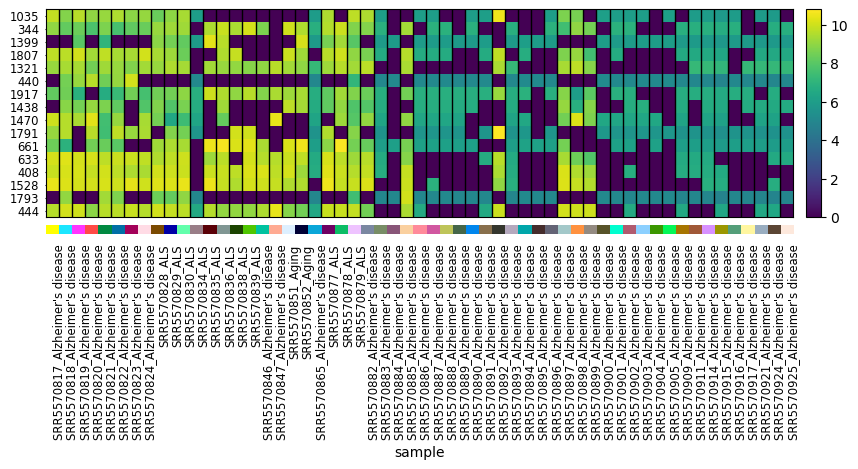

Plotting 14 genes for B_Cells...


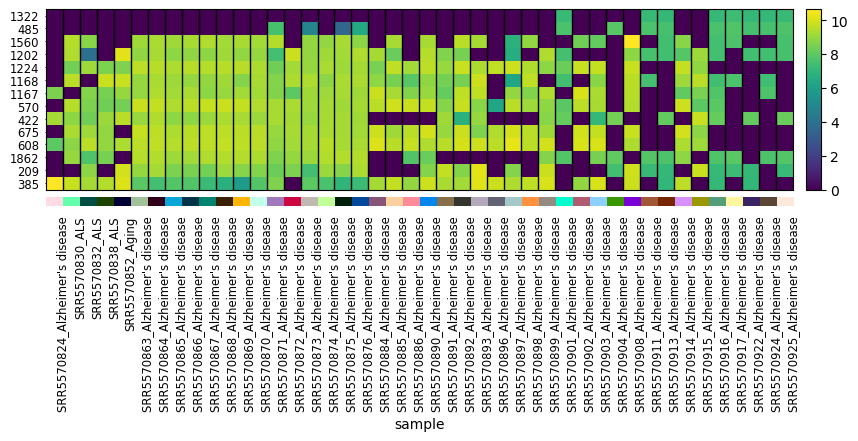

Plotting 0 genes for Cytoskeleton...
No genes meet the criteria for Cytoskeleton.
Plotting 396 genes for Dendritic_Cells...


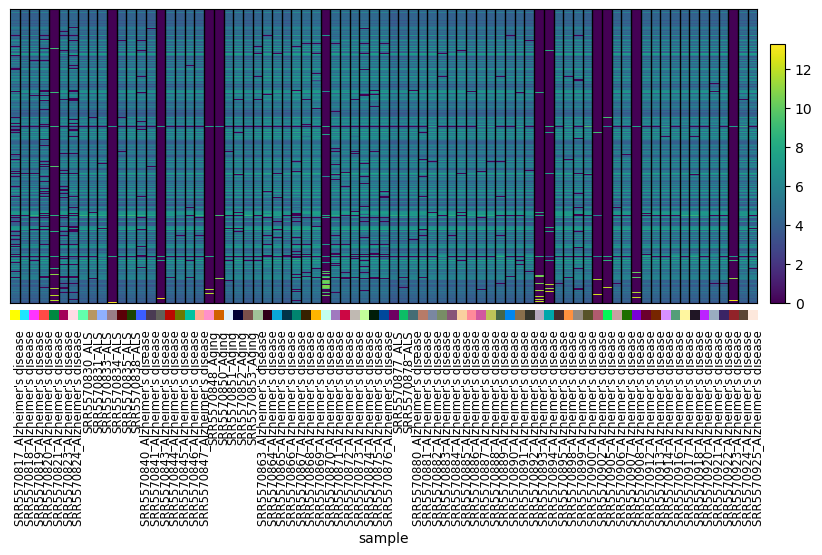

Plotting 17 genes for Endothelial_Cells...


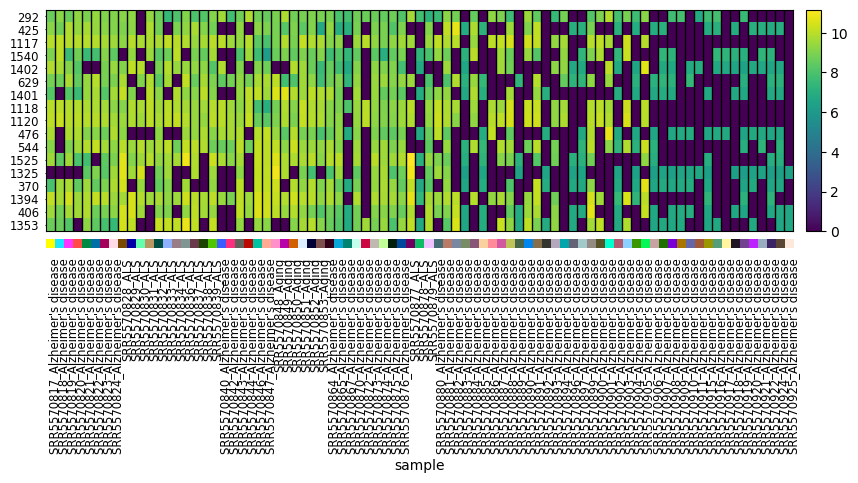

Plotting 0 genes for Eosinophils_Basophils...
No genes meet the criteria for Eosinophils_Basophils.
Plotting 259 genes for Erythrocytes...


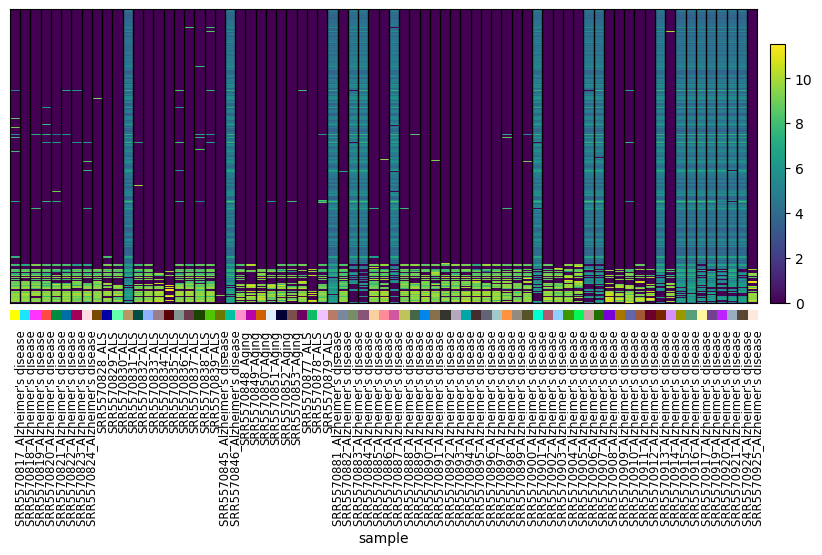

Plotting 9 genes for Excitatory_Neurons...


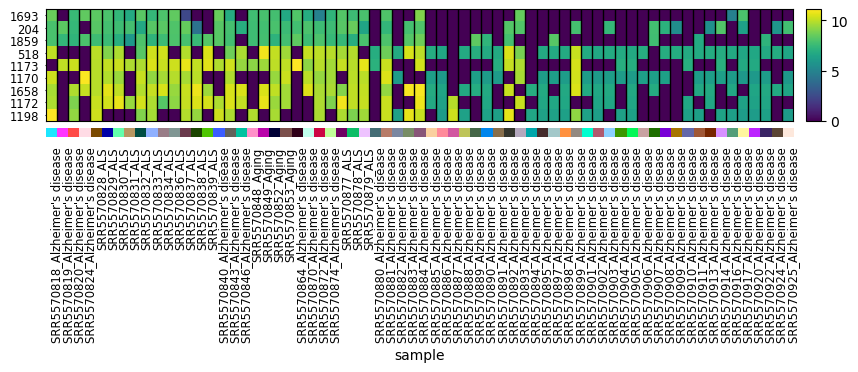

Plotting 87 genes for Fibroblasts...


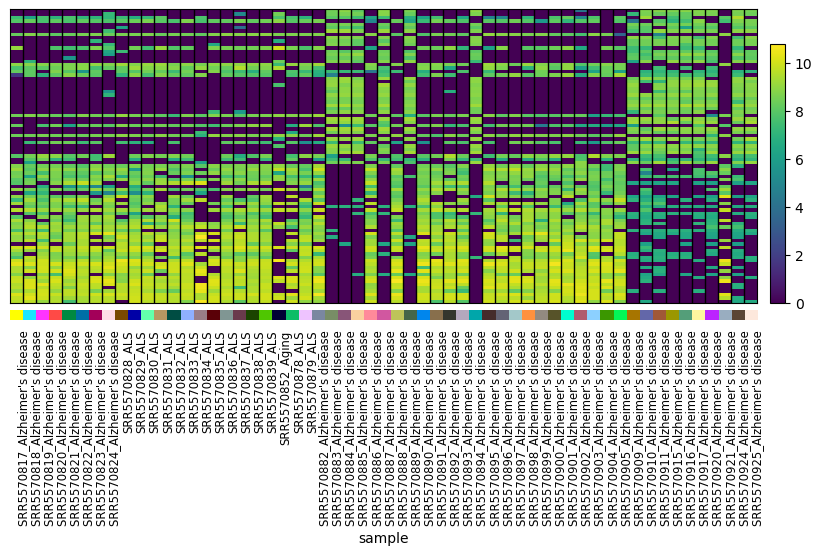

Plotting 1 genes for Hematopoietic_Stem_Cells...


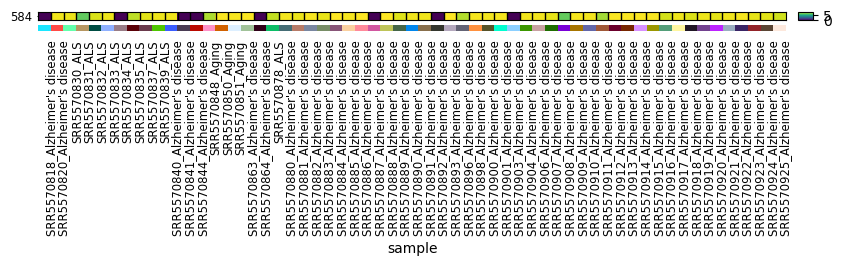

Plotting 0 genes for Housekeeping_Genes...
No genes meet the criteria for Housekeeping_Genes.
Plotting 0 genes for Inhibitory_Neurons...
No genes meet the criteria for Inhibitory_Neurons.
Plotting 0 genes for Lymphatic_Endothelial_Cells...
No genes meet the criteria for Lymphatic_Endothelial_Cells.
Plotting 503 genes for Megakaryocytes...


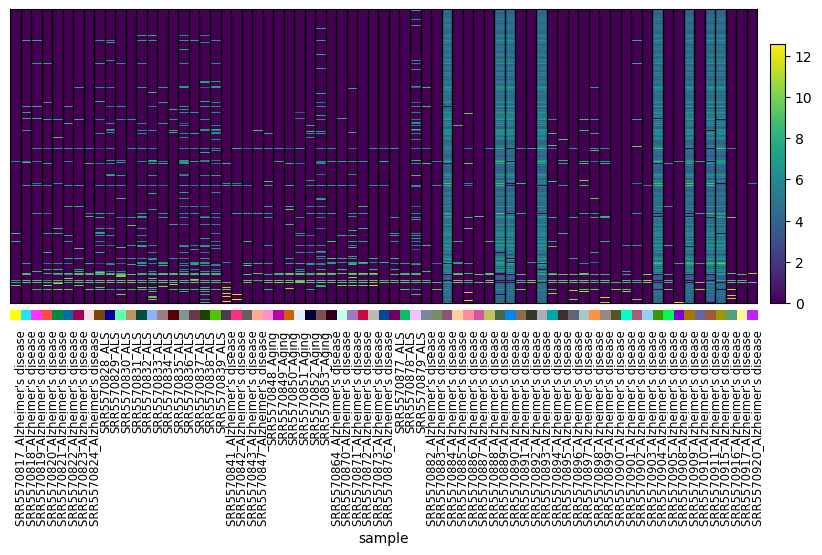

Plotting 0 genes for Microglia_Macrophages...
No genes meet the criteria for Microglia_Macrophages.
Plotting 1319 genes for Neutrophils...


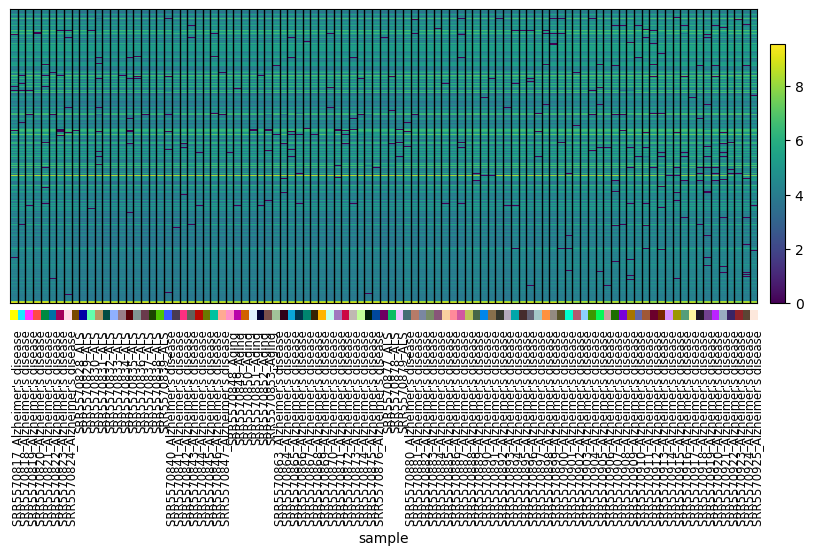

Plotting 174 genes for Oligodendrocytes...


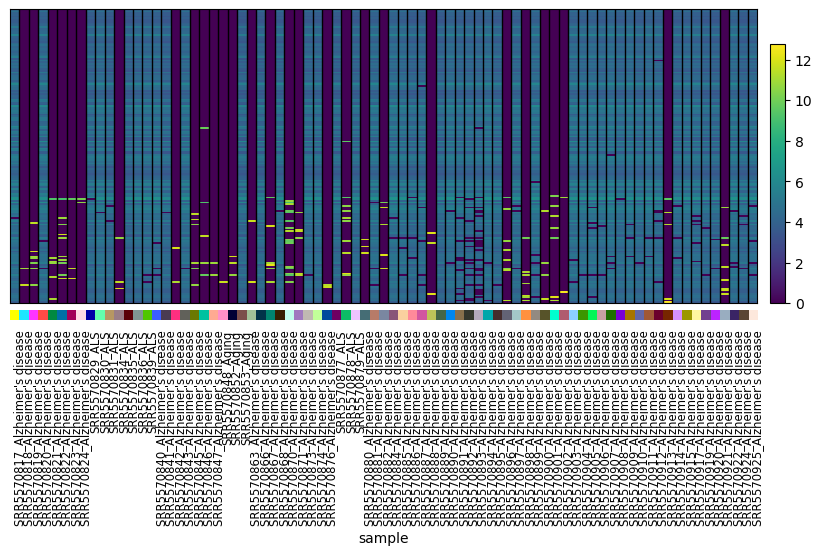

Plotting 0 genes for Plasma_Cells...
No genes meet the criteria for Plasma_Cells.
Plotting 7 genes for Stress_Response...


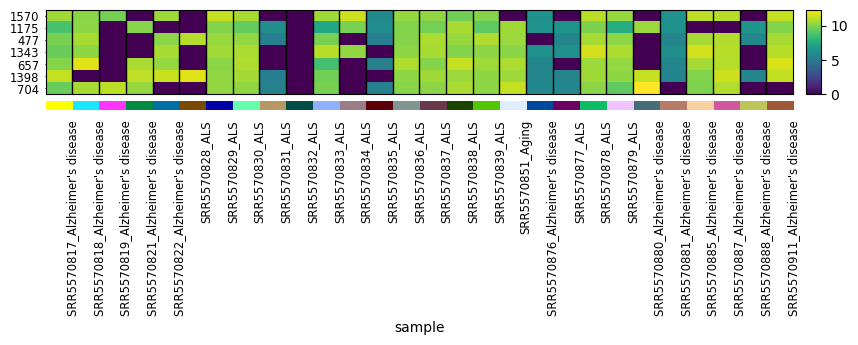

Plotting 1426 genes for T_Cells...


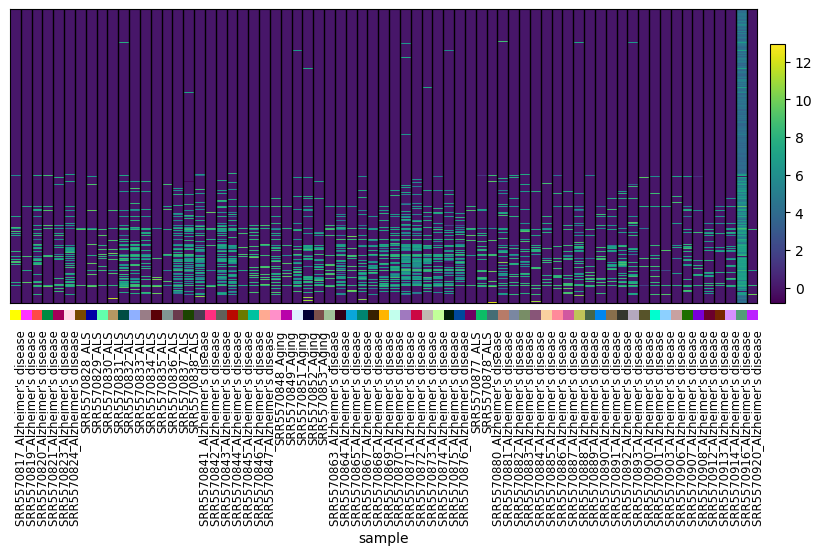

In [198]:
# Plot heatmap for CD14+ Monocytes using edgeR results
for cell_type, df in de_per_cell_type.items():
    plot_heatmap(adata_pb, f"edgeR_{cell_type}")

In [199]:
def plot_volcano(adata, group_key, group_name="cell_type"):
    """
    Plots a volcano plot for a given cell type's DE results.
    
    Parameters:
    - adata: AnnData object
    - group_key: Key in .uns where DE results are stored
    - group_name: Column in .obs containing cell type information (default: "cell_type")
    """
    cell_type = "_".join(group_key.split("_")[1:])  # Extract cell type from key
    res = sc.get.rank_genes_groups_df(adata, group=cell_type, key=group_key)

    # Ensure all values in pvals_adj are valid
    res["pvals_adj"] = pd.to_numeric(res["pvals_adj"], errors="coerce")
    res = res.dropna(subset=["pvals_adj", "logfoldchanges"])  # Drop rows with NaNs
    res["pvals_adj"] = res["pvals_adj"].replace(0, 1e-300)  # Replace 0 with a small value

    # Add a column to indicate significance
    res["Significant"] = (res["pvals_adj"] < FDR) & (abs(res["logfoldchanges"]) > LOG_FOLD_CHANGE)

    # Plot the volcano
    plt.figure(figsize=(10, 6))
    sns.scatterplot(
        x="logfoldchanges",
        y=-np.log10(res["pvals_adj"]),
        hue="Significant",
        data=res,
        palette={True: "red", False: "grey"},
    )
    plt.axvline(x=LOG_FOLD_CHANGE, color="blue", linestyle="--")
    plt.axvline(x=-LOG_FOLD_CHANGE, color="blue", linestyle="--")
    plt.axhline(y=-np.log10(FDR), color="green", linestyle="--")
    plt.title(f"Volcano Plot: {cell_type}")
    plt.xlabel("Log Fold Change")
    plt.ylabel("-log10(FDR)")
    plt.legend(title="Significant", loc="upper right")
    plt.show()


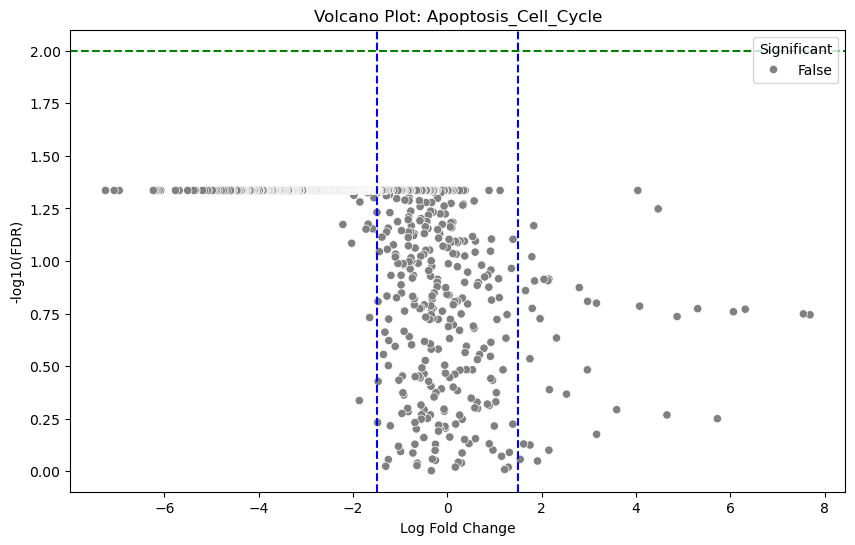

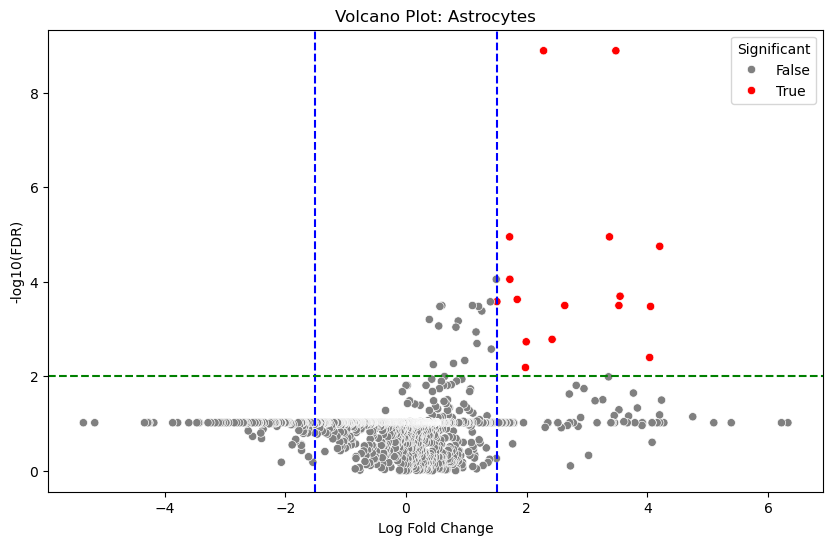

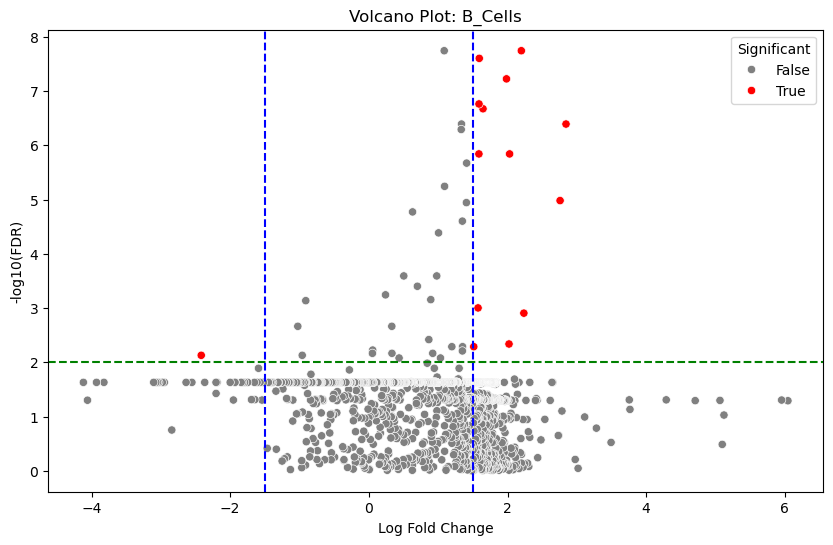

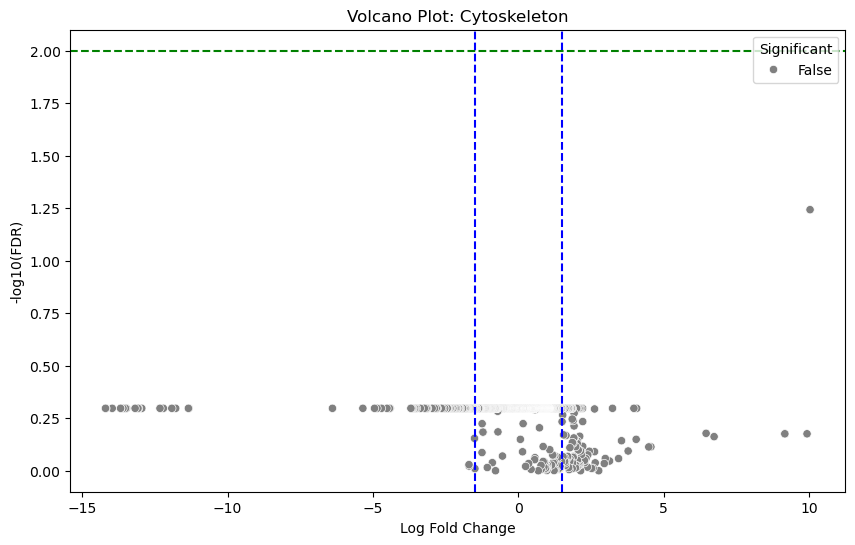

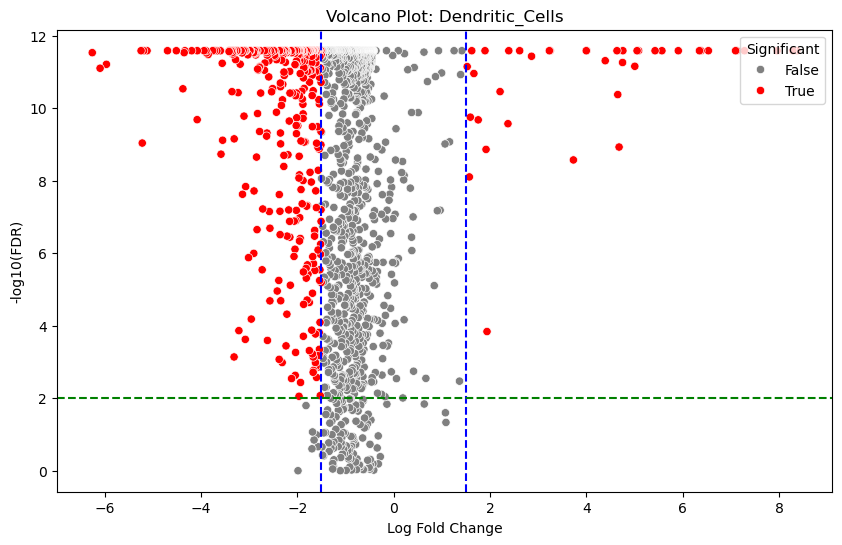

...

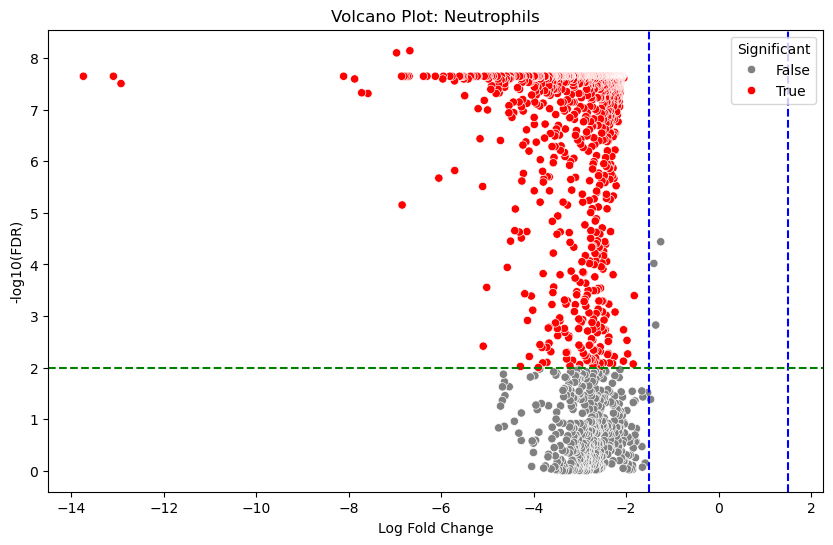

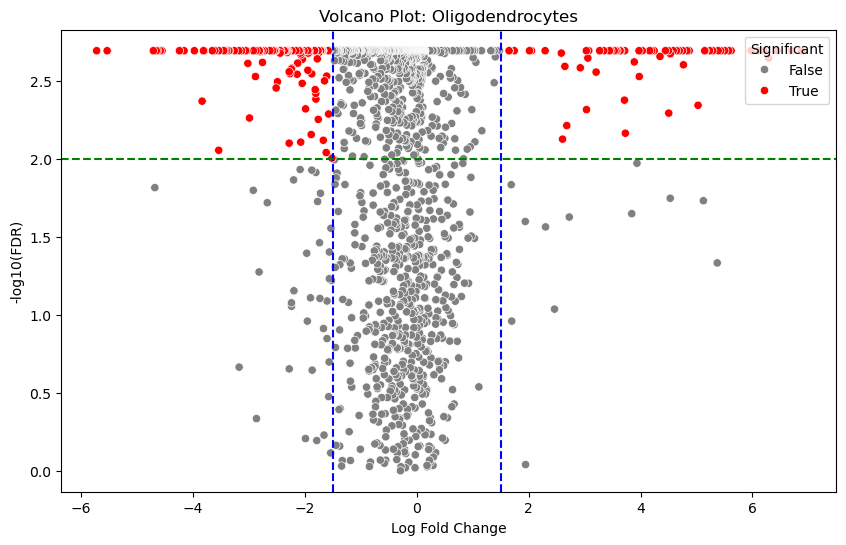

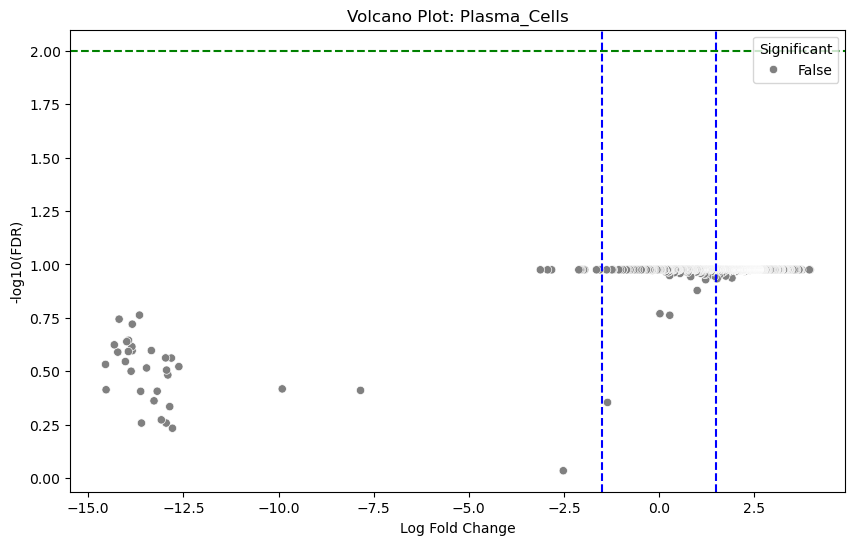

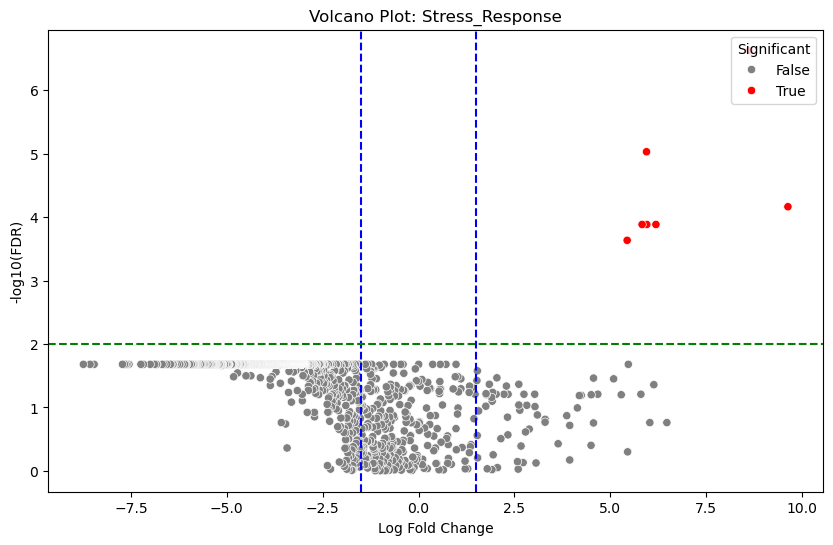

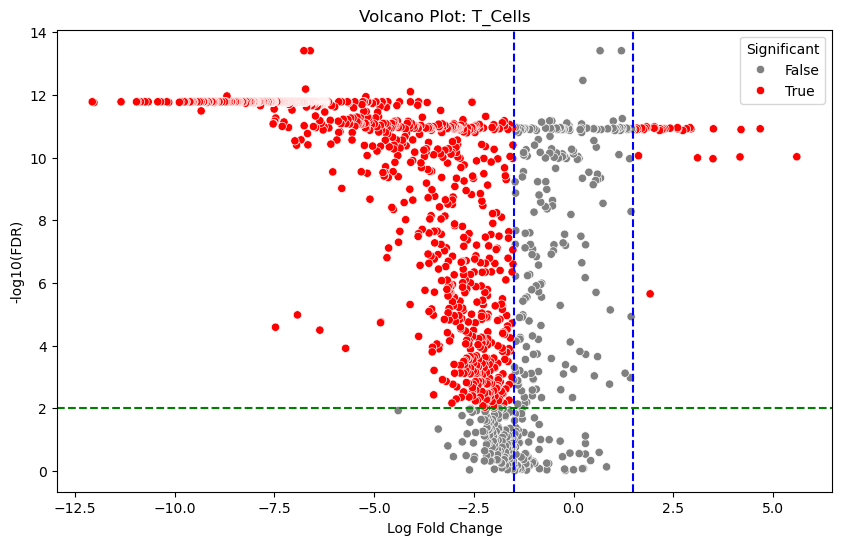

In [200]:
# Plot heatmap for CD14+ Monocytes using edgeR results
for cell_type, df in de_per_cell_type.items():
    plot_volcano(adata_pb, f"edgeR_{cell_type}")

This volcano plot represents the results of a differential expression analysis for T_Cells. Here's what it implies:

1. **Axes**:
   - The x-axis shows the **log fold change (logFC)** in gene expression between conditions. 
     - Positive values indicate upregulation in T_Cells.
     - Negative values indicate downregulation.
   - The y-axis shows **-log10(FDR-adjusted p-values)**. 
     - Higher values indicate greater statistical significance.

2. **Thresholds**:
   - The vertical blue dashed lines represent the **log fold change threshold** (±1.5). 
     - Genes outside these lines have substantial changes in expression.
   - The horizontal green dashed line represents the **FDR threshold (0.01)**. 
     - Genes above this line are statistically significant.

3. **Points**:
   - **Red points**: Genes that meet both criteria for differential expression (significant FDR and logFC > 1.5 or < -1.5). These are the **significantly differentially expressed genes** (DEGs).
   - **Gray points**: Genes that do not meet the criteria. These are either not statistically significant or do not show a strong enough fold change.

**Implications:**
1. **Upregulated Genes**:
   - Genes with high positive logFC (on the right of the plot) and significant FDR are upregulated in T_Cells under the condition being tested.

2. **Downregulated Genes**:
   - Genes with high negative logFC (on the left of the plot) and significant FDR are downregulated in T_Cells.

3. **Biological Insight**:
   - The plot highlights genes whose expression levels are strongly and significantly altered in T_Cells compared to other conditions or groups.
   - These genes may be of biological interest for further investigation, as they could be critical markers, pathways, or regulators involved in the processbased on specific research goals.

## Compositional analysis 

In [201]:
pip install pertpy[coda]

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [70]:
adata_pb = sc.read("adata_pb.h5ad")

In [72]:
adata_pb

AnnData object with n_obs × n_vars = 1075 × 1815
    obs: 'treatment', 'strain', 'total_counts', 'cell_type', 'sample', 'lib_size', 'log_lib_size'
    uns: 'cell_type_colors', 'edgeR_Apoptosis_Cell_Cycle', 'log1p', 'pca', 'sample_colors', 'strain_colors', 'treatment_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [71]:
adata_pb.obs

,treatment,strain,total_counts,cell_type,sample,lib_size,log_lib_size
SRR5570818_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,400.0,Apoptosis_Cell_Cycle,SRR5570818_Alzheimer's disease,980.179585,6.887736
SRR5570819_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,C57BL/6,298.0,Apoptosis_Cell_Cycle,SRR5570819_Alzheimer's disease,855.641303,6.751851
SRR5570846_Alzheimer's disease-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Alzheimer's disease,5XFAD,656.0,Apoptosis_Cell_Cycle,SRR5570846_Alzheimer's disease,1603.937338,7.380217
SRR5570848_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,601.0,Apoptosis_Cell_Cycle,SRR5570848_Aging,1447.804555,7.277804
SRR5570849_Aging-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,Aging,C57BL/6,550.0,Apoptosis_Cell_Cycle,SRR5570849_Aging,1195.856718,7.086618
...,...,...,...,...,...,...,...
SRR5570912_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1204.0,T_Cells,SRR5570912_Alzheimer's disease,2188.531762,7.690986
SRR5570913_Alzheimer's disease-1,Alzheimer's disease,5XFAD,854.0,T_Cells,SRR5570913_Alzheimer's disease,2093.222512,7.646460
SRR5570914_Alzheimer's disease-1,Alzheimer's disease,5XFAD,1943.0,T_Cells,SRR5570914_Alzheimer's disease,2228.726024,7.709185
SRR5570916_Alzheimer's disease-1,Alzheimer's disease,5XFAD,596.0,T_Cells,SRR5570916_Alzheimer's disease,12053.536592,9.397113


In [5]:
# Clean sample identifiers in adata_pb
adata_pb.obs["normalized_sample"] = adata_pb.obs["sample"].str.extract(r"(SRR\d+.*)")

In [6]:
import pertpy as pt

sccoda_model = pt.tl.Sccoda()


/ext3/miniconda3/lib/python3.12/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


In [ ]:
# Load the sccoda_data
sccoda_data = sccoda_model.load(
    adata,
    type="cell_level",  # Use 'cell_level' for single-cell or pseudobulk data
    generate_sample_level=True,
    cell_type_identifier="cell_type",  # Column identifying cell types
    sample_identifier="sample",       # Column identifying samples
    covariate_obs=["treatment"],      # Column for experimental conditions
)

sccoda_data

/home/hr2547/.local/lib/python3.12/site-packages/pertpy/tools/_coda/_base_coda.py:1708: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(cell_types, rotation=90)


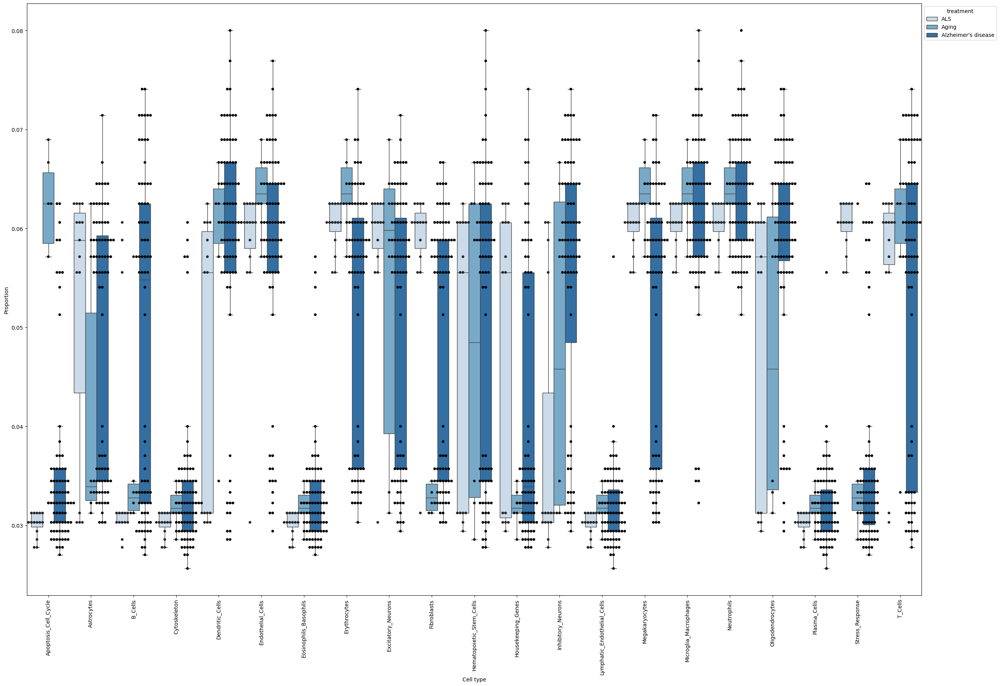

In [15]:
sccoda_model.plot_boxplots(
    sccoda_data,
    modality_key="coda",
    feature_name="treatment",
    figsize=(30, 20),
    add_dots=True,
    args_swarmplot={},
)
plt.show()

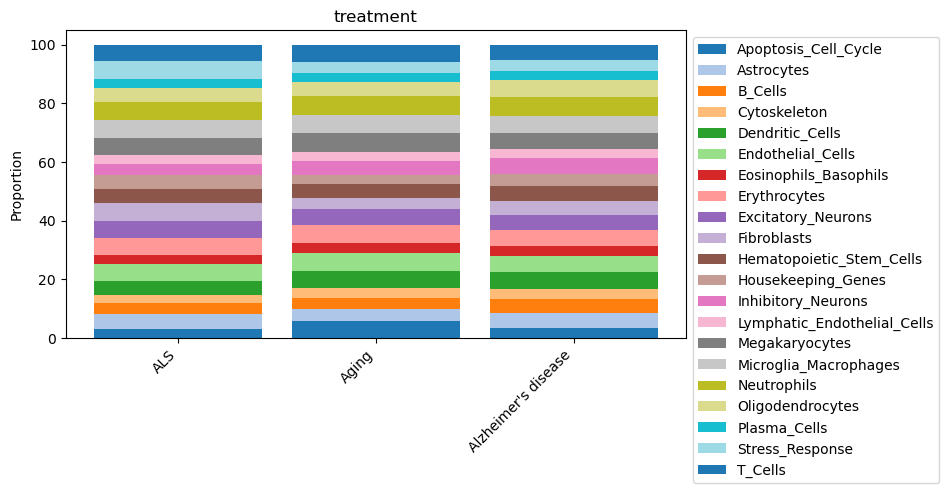

In [16]:
sccoda_model.plot_stacked_barplot(
    sccoda_data, modality_key="coda", feature_name="treatment", figsize=(8, 4)
)
plt.show()

In [17]:
sccoda_data = sccoda_model.prepare(
    sccoda_data,
    modality_key="coda",
    formula="treatment",
    reference_cell_type="automatic",
)
sccoda_model.run_nuts(sccoda_data, modality_key="coda", rng_key=1234)

• Automatic reference selection! Reference cell type set to Plasma_Cells


sample: 100%|██████████| 11000/11000 [05:51<00:00, 31.32it/s, 63 steps of size 5.08e-02. acc. prob=0.81] 


In [18]:
sccoda_data["coda"].varm["effect_df_treatment[T.Aging]"]

,Final Parameter,HDI 3%,HDI 97%,SD,Inclusion probability,Expected Sample,log2-fold change
Cell Type,,,,,,,
Apoptosis_Cell_Cycle,0.0,-0.271,0.424,0.134,0.5295,0.576122,0.0
Astrocytes,0.0,-0.345,0.303,0.117,0.5104,0.794982,0.0
B_Cells,0.0,-0.350,0.312,0.122,0.5160,0.717175,0.0
Cytoskeleton,0.0,-0.368,0.286,0.119,0.5111,0.522341,0.0
Dendritic_Cells,0.0,-0.304,0.328,0.111,0.5035,0.890978,0.0
Endothelial_Cells,0.0,-0.274,0.323,0.107,0.5058,0.931056,0.0
Eosinophils_Basophils,0.0,-0.328,0.334,0.121,0.5074,0.517143,0.0
Erythrocytes,0.0,-0.253,0.372,0.114,0.5082,0.882113,0.0
Excitatory_Neurons,0.0,-0.299,0.304,0.113,0.5054,0.850921,0.0


In [19]:
sccoda_data["coda"].varm["effect_df_treatment[T.Alzheimer's disease]"]

,Final Parameter,HDI 3%,HDI 97%,SD,Inclusion probability,Expected Sample,log2-fold change
Cell Type,,,,,,,
Apoptosis_Cell_Cycle,0.0,-0.220,0.193,0.074,0.4891,0.576122,0.0
Astrocytes,0.0,-0.184,0.217,0.072,0.4940,0.794982,0.0
B_Cells,0.0,-0.167,0.258,0.082,0.5035,0.717175,0.0
Cytoskeleton,0.0,-0.168,0.243,0.075,0.5032,0.522341,0.0
Dendritic_Cells,0.0,-0.142,0.251,0.074,0.4995,0.890978,0.0
Endothelial_Cells,0.0,-0.210,0.172,0.070,0.4885,0.931056,0.0
Eosinophils_Basophils,0.0,-0.216,0.207,0.077,0.5005,0.517143,0.0
Erythrocytes,0.0,-0.233,0.161,0.072,0.4895,0.882113,0.0
Excitatory_Neurons,0.0,-0.218,0.179,0.071,0.4875,0.850921,0.0


In [20]:
sccoda_model.set_fdr(sccoda_data, 0.2)

In [21]:
sccoda_model.credible_effects(sccoda_data, modality_key="coda")

Covariate                         Cell Type                  
treatment[T.Aging]                Apoptosis_Cell_Cycle           False
                                  Astrocytes                     False
                                  B_Cells                        False
                                  Cytoskeleton                   False
                                  Dendritic_Cells                False
                                  Endothelial_Cells              False
                                  Eosinophils_Basophils          False
                                  Erythrocytes                   False
                                  Excitatory_Neurons             False
                                  Fibroblasts                    False
                                  Hematopoietic_Stem_Cells       False
                                  Housekeeping_Genes             False
                                  Inhibitory_Neurons             False
               

In [32]:
valid_treatment_data = pd.concat(
    [
        sccoda_data["coda"].varm["effect_df_treatment[T.Aging]"].loc[valid_covariates],
        sccoda_data["coda"].varm["effect_df_treatment[T.Alzheimer's disease]"].loc[valid_covariates],
    ],
    keys=["Aging", "Alzheimer's disease"],
    names=["Treatment"]
)
valid_treatment_data


Final Parameter  HDI 3%  \
Treatment           cell_type                                              
Aging               Apoptosis_Cell_Cycle                     0.0  -0.271   
                    Astrocytes                               0.0  -0.345   
                    B_Cells                                  0.0  -0.350   
                    Cytoskeleton                             0.0  -0.368   
                    Dendritic_Cells                          0.0  -0.304   
                    Endothelial_Cells                        0.0  -0.274   
                    Eosinophils_Basophils                    0.0  -0.328   
                    Erythrocytes                             0.0  -0.253   
                    Excitatory_Neurons                       0.0  -0.299   
                    Fibroblasts                              0.0  -0.383   
                    Hematopoietic_Stem_Cells                 0.0  -0.338   
                    Housekeeping_Genes                       0.0  -0.364   
                    Inhibitory_Neurons                       0.0  -0.325   
                    Lymphatic_Endothelial_Cells              0.0  -0.360   
                    Megakaryocytes                           0.0  -0.276   
                    Microglia_Macrophages                    0.0  -0.259   
                    Neutrophils                              0.0  -0.309   
                    Oligodendrocytes                         0.0  -0.382   
                    Plasma_Cells                             0.0   0.000   
                    Stress_Response                          0.0  -0.348   
                    T_Cells                                  0.0  -0.276   
Alzheimer's disease Apoptosis_Cell_Cycle                     0.0  -0.220   
                    Astrocytes                               0.0  -0.184   
                    B_Cells                                  0.0  -0.167   
                    Cytoskeleton                             0.0  -0.168   
                    Dendritic_Cells                          0.0  -0.142   
                    Endothelial_Cells                        0.0  -0.210   
                    Eosinophils_Basophils                    0.0  -0.216   
                    Erythrocytes                             0.0  -0.233   
                    Excitatory_Neurons                       0.0  -0.218   
                    Fibroblasts                              0.0  -0.212   
                    Hematopoietic_Stem_Cells                 0.0  -0.168   
                    Housekeeping_Genes                       0.0  -0.216   
                    Inhibitory_Neurons                       0.0  -0.139   
                    Lymphatic_Endothelial_Cells              0.0  -0.182   
                    Megakaryocytes                           0.0  -0.227   
                    Microglia_Macrophages                    0.0  -0.180   
                    Neutrophils                              0.0  -0.172   
                    Oligodendrocytes                         0.0  -0.182   
                    Plasma_Cells                             0.0   0.000   
                    Stress_Response                          0.0  -0.319   
                    T_Cells                                  0.0  -0.218   

                                                 HDI 97%     SD  \
Treatment           cell_type                                     
Aging               Apoptosis_Cell_Cycle           0.424  0.134   
                    Astrocytes                     0.303  0.117   
                    B_Cells                        0.312  0.122   
                    Cytoskeleton                   0.286  0.119   
                    Dendritic_Cells                0.328  0.111   
                    Endothelial_Cells              0.323  0.107   
                    Eosinophils_Basophils          0.334  0.121   
                    Erythrocytes                   0.372  0.114   
                    Excitatory_Neu

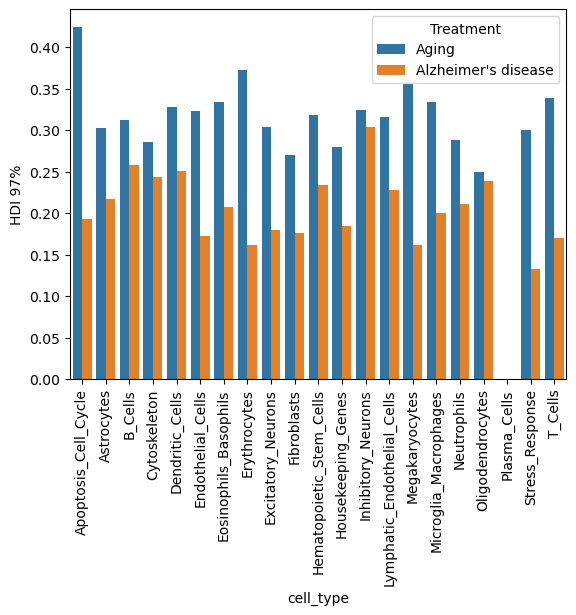

In [33]:

valid_treatment_data = valid_treatment_data.reset_index()
sns.barplot(
    data=valid_treatment_data,
    x="cell_type",
    y="HDI 97%",  # the column representing effect size
    hue="Treatment"
)
plt.xticks(rotation=90)
plt.show()


## Pathway enrichment analysis

In [22]:
!pip install omnipath

Defaulting to user installation because normal site-packages is not writeable


In [21]:
import muon as mu
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scanpy as sc
import random
import decoupler
import pandas as pd
import anndata as ad

In [22]:
adata = sc.read("annotated_rna_data_2.h5ad")

In [23]:
adata

AnnData object with n_obs × n_vars = 37248 × 2018
    obs: 'Run', 'Assay Type', 'AvgSpotLen', 'Bases', 'BioProject', 'BioSample', 'Bytes', 'Center Name', 'Consent', 'DATASTORE filetype', 'DATASTORE provider', 'DATASTORE region', 'Experiment', 'GEO_Accession (exp)', 'Instrument', 'LibraryLayout', 'LibrarySelection', 'LibrarySource', 'mouse_age', 'Organ', 'Organism', 'Platform', 'ReleaseDate', 'create_date', 'version', 'selection_marker', 'source_name', 'SRA Study', 'strain', 'treatment', 'total_counts', 'n_genes_by_counts', 'leiden', 'leiden_numeric', 'cell_type'
    var: 'capped_mean', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'dea_leiden_2', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [24]:
adata.obs

,Run,Assay Type,AvgSpotLen,Bases,BioProject,BioSample,Bytes,Center Name,Consent,DATASTORE filetype,...,selection_marker,source_name,SRA Study,strain,treatment,total_counts,n_genes_by_counts,leiden,leiden_numeric,cell_type
W660497,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,532.0,47,3,3,Neutrophils
W660498,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1221.0,76,1,1,Microglia/Macrophages
W660499,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1260.0,82,1,1,Microglia/Macrophages
W660500,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1252.0,69,1,1,Microglia/Macrophages
W660501,SRR5570912,RNA-Seq,66.0,1.727998e+09,PRJNA387079,SAMN07134176,2.790797e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Cortex,SRP107339,5XFAD,Alzheimer's disease,1097.0,72,6,6,Dendritic Cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W625932,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,746.0,70,1,1,Microglia/Macrophages
W625933,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1032.0,86,16,16,Housekeeping Genes
W625934,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,914.0,80,1,1,Microglia/Macrophages
W625935,SRR5570900,RNA-Seq,66.0,1.311093e+09,PRJNA387079,SAMN07134158,2.140770e+09,GEO,public,"fastq,run.zq,sra",...,CD45+,Whole brain,SRP107339,C57BL/6,Alzheimer's disease,1609.0,119,0,0,Microglia/Macrophages


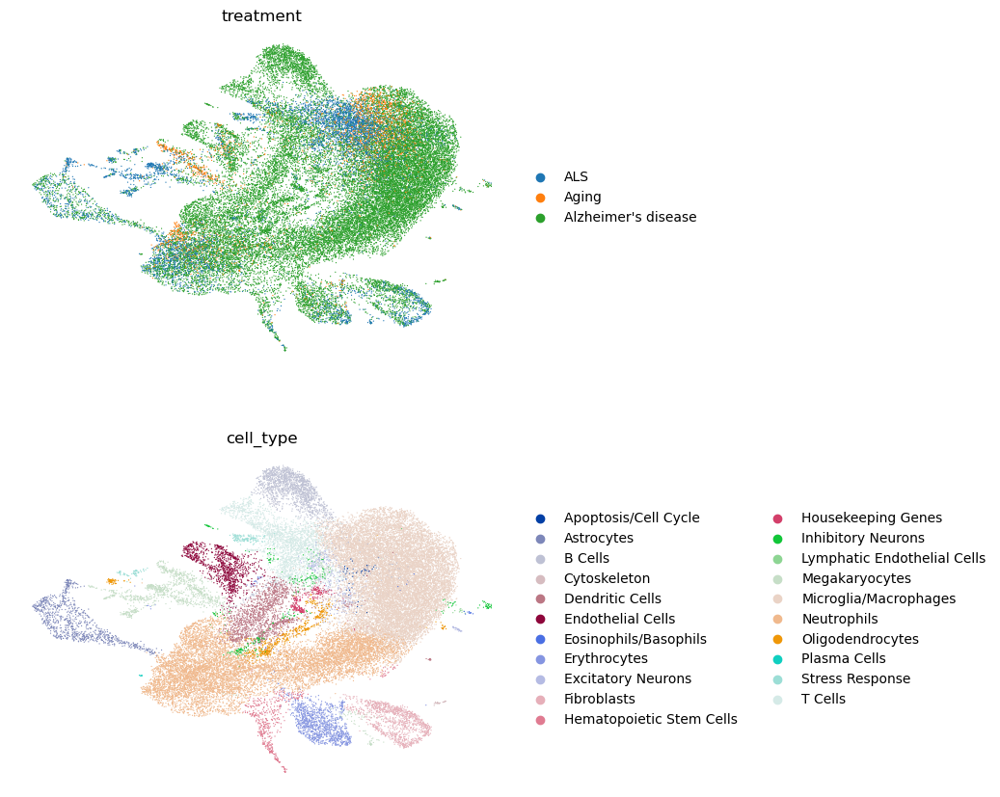

In [25]:
sc.pl.umap(adata, color=["treatment", "cell_type"], frameon=False, ncols=1)


In [26]:
adata.obs["group"] = adata.obs.treatment.astype("string") + "_" + adata.obs.cell_type

In [27]:
# Get valid groups with at least 2 samples
valid_groups = adata.obs["group"].value_counts().loc[lambda x: x >= 2].index

# Filter the dataset
adata = adata[adata.obs["group"].isin(valid_groups)].copy()
adata.obs["group"].unique()

<StringArray>
[                "Alzheimer's disease_Neutrophils",
       "Alzheimer's disease_Microglia/Macrophages",
             "Alzheimer's disease_Dendritic Cells",
                     "Alzheimer's disease_T Cells",
                "Alzheimer's disease_Erythrocytes",
          "Alzheimer's disease_Excitatory Neurons",
            "Alzheimer's disease_Oligodendrocytes",
    "Alzheimer's disease_Hematopoietic Stem Cells",
          "Alzheimer's disease_Inhibitory Neurons",
              "Alzheimer's disease_Megakaryocytes",
           "Alzheimer's disease_Endothelial Cells",
                 "Alzheimer's disease_Fibroblasts",
                     "Alzheimer's disease_B Cells",
       "Alzheimer's disease_Eosinophils/Basophils",
                  "Alzheimer's disease_Astrocytes",
          "Alzheimer's disease_Housekeeping Genes",
                                 'ALS_Neutrophils',
                       'ALS_Microglia/Macrophages',
                                     'ALS_T Cells'

In [28]:
df =sc.tl.rank_genes_groups(adata, "group", method="t-test", key_added="t-test")


/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/ext3/miniconda3/lib/python3.12/site-packages/scan

In [29]:
df

In [30]:
celltype_condition = "Alzheimer's disease_Microglia/Macrophages"
t_stats = (
    sc.get.rank_genes_groups_df(adata, celltype_condition, key="t-test")
    .set_index("names")
    .loc[adata.var["highly_variable"]]
    .sort_values("scores", key=np.abs, ascending=False)
    [["scores"]]
    .rename_axis(["Alzheimer's disease_Microglia_Macrophages"], axis=1)
)


In [31]:
t_stats.index = t_stats.index.str.upper()

In [41]:
# Filter rows where the 'scores' column has values greater than 0
t_stats = t_stats[t_stats['scores'] > 0]

t_stats

Alzheimer's disease_Microglia_Macrophages,scores
names,
CST3,130.409134
HEXB,127.359177
P2RY12,112.137566
SPARC,110.329529
SELPLG,104.909401
...,...
IQCG,0.020970
HGD,0.018744
PLCB4,0.018425


### Cluster-level gene set enrichment analysis with decoupler

In [33]:
reactome = decoupler.get_resource("MSigDB").query("collection == 'reactome_pathways'")
reactome = reactome[~reactome.duplicated(("geneset", "genesymbol"))]


0.00B [00:00, ?B/s]

0.00B [00:00, ?B/s]

In [34]:
reactome

,genesymbol,collection,geneset
200,MAFF,reactome_pathways,REACTOME_HEMOSTASIS
342,MAFF,reactome_pathways,REACTOME_FACTORS_INVOLVED_IN_MEGAKARYOCYTE_DEV...
718,IER3,reactome_pathways,REACTOME_INTRACELLULAR_SIGNALING_BY_SECOND_MES...
859,IER3,reactome_pathways,REACTOME_NEGATIVE_REGULATION_OF_THE_PI3K_AKT_N...
1104,PHLDA1,reactome_pathways,REACTOME_MITOTIC_G2_G2_M_PHASES
...,...,...,...
3838483,KIR2DS2,reactome_pathways,REACTOME_DAP12_INTERACTIONS
3838489,KIR2DS2,reactome_pathways,REACTOME_INNATE_IMMUNE_SYSTEM
3838499,KIR2DS2,reactome_pathways,REACTOME_ADAPTIVE_IMMUNE_SYSTEM
3838530,KIR3DS1,reactome_pathways,REACTOME_DAP12_INTERACTIONS


In [35]:
geneset_size = reactome.groupby("geneset").size()
gsea_genesets = geneset_size.index[(geneset_size > 15) & (geneset_size < 500)]


/state/partition1/job-54299459/ipykernel_3042077/4261157407.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  geneset_size = reactome.groupby("geneset").size()


In [36]:
# Check overlap
shared_genes = set(t_stats.index) & set(reactome["genesymbol"])
print(f"Number of shared genes: {len(shared_genes)}")
print(f"shared genes: {shared_genes}")


Number of shared genes: 723
shared genes: {'CD300LD', 'TOMT', 'CENPF', 'APOB', 'ARL13B', 'GYS2', 'AQP7', 'ANK2', 'VIP', 'ABCE1', 'SLC4A7', 'RAB5A', 'ACACB', 'SLK', 'PTGS2', 'PHIP', 'ST6GALNAC3', 'CHIA', 'IGF2', 'FCER1G', 'HSPA1B', 'GAN', 'ADAMTS12', 'PLBD1', 'RPS19BP1', 'DOK4', 'GLI2', 'CD81', 'FBXO44', 'NLGN1', 'THY1', 'IFIT3', 'SENP8', 'TAS1R1', 'MPO', 'NCL', 'RETN', 'ENO3', 'RPL14', 'LEF1', 'CCR7', 'TUBA4A', 'TMF1', 'RRM2', 'SLX4', 'BMP10', 'ST6GALNAC1', 'FAM131B', 'ADAMTS18', 'HGD', 'SOX9', 'F13A1', 'PCSK5', 'FBXO40', 'RAD51', 'ASB5', 'COL11A2', 'CACNA1G', 'IL10', 'TPK1', 'LENG1', 'CTSB', 'MCM6', 'FZD6', 'GATA2', 'DZIP1', 'CD52', 'GHR', 'LGI2', 'RBP3', 'GUCY2F', 'ITGA2', 'KL', 'ICAM5', 'ACBD7', 'TOMM40', 'CALB1', 'TUBA1B', 'MAOB', 'DUOX2', 'NOG', 'IER3', 'ATP6V1D', 'CLIP3', 'SMARCA4', 'OXT', 'ROR1', 'CWF19L2', 'IFIT1', 'CTH', 'CATSPER3', 'ST8SIA5', 'KCNJ6', 'SLC28A3', 'KREMEN1', 'TTLL2', 'KIF2B', 'RSAD2', 'COL1A2', 'GRN', 'CIDEA', 'SERPINE1', 'TOP2A', 'PCYT1B', 'NPAS4', 'LPAR3', 'P

###  Running GSEA

In [42]:
scores, norm, pvals = decoupler.run_gsea(
    t_stats.T,
    reactome[reactome["geneset"].isin(gsea_genesets)],
    source="geneset",
    target="genesymbol",
    min_n=2 
)


In [45]:
gsea_results = (
    pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
    .droplevel(level=1, axis=1)
    .sort_values("pval")
)


In [46]:
gsea_results.head(10)

,score,norm,pval
source,,,
REACTOME_G_ALPHA_I_SIGNALLING_EVENTS,0.950617,1.483412,0.000000
REACTOME_SIGNALING_BY_PDGF,-0.973568,-1.562330,0.000000
REACTOME_NEUTROPHIL_DEGRANULATION,0.879979,1.353477,0.003003
REACTOME_ECM_PROTEOGLYCANS,0.994922,1.389706,0.003086
REACTOME_METABOLISM_OF_AMINO_ACIDS_AND_DERIVATIVES,0.943474,1.451849,0.005388
REACTOME_CROSSLINKING_OF_COLLAGEN_FIBRILS,-0.944200,-1.530993,0.005556
REACTOME_COMPLEMENT_CASCADE,0.969072,1.461774,0.009581
REACTOME_PEPTIDE_LIGAND_BINDING_RECEPTORS,0.973139,1.446557,0.010204
REACTOME_EXTRACELLULAR_MATRIX_ORGANIZATION,0.930089,1.436425,0.010515
